<a href="https://colab.research.google.com/github/FilipAngelov/Mask_and_Age_Classification/blob/master/Mask_and_Age_Classification_.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**Import Libraries**

In [ ]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications import MobileNetV2
from tensorflow.keras.layers import AveragePooling2D
from tensorflow.keras.layers import Dropout
from tensorflow.keras.layers import Flatten
from tensorflow.keras.layers import Dense
from tensorflow.keras.layers import Input
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.optimizers import SGD 
from tensorflow.keras.applications.mobilenet_v2 import preprocess_input
from tensorflow.keras.preprocessing.image import img_to_array
from tensorflow.keras.preprocessing.image import load_img
from tensorflow.keras.utils import to_categorical
import tensorflow as tf
from tensorboard.plugins.hparams import api as hp
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report
import matplotlib.pyplot as plt
import numpy as np
import os

**Import Data**

In [ ]:
from pydrive.auth import GoogleAuth
from pydrive.drive import GoogleDrive
from google.colab import auth
from oauth2client.client import GoogleCredentials

auth.authenticate_user()
gauth = GoogleAuth()
gauth.credentials = GoogleCredentials.get_application_default()
drive = GoogleDrive(gauth)

fid = drive.ListFile({'q':"title='dataset.zip'"}).GetList()[0]['id']
f = drive.CreateFile({'id': fid})
f.GetContentFile('dataset.zip')

**Unzip Data**

In [ ]:
!unzip -q dataset.zip
print("Data is unzipped")

Data is unzipped


**Load Files**

In [ ]:
from sklearn.datasets import load_files  
import numpy as np
from keras.utils import np_utils

def load_dataset(path):
    data = load_files(path)
    files = np.array(data['filenames'])
    targets = np_utils.to_categorical(np.array(data['target']), 4)
    names = data['target_names']
    return files, targets, names

files, targets, names = load_dataset('dataset')

Using TensorFlow backend.


In [ ]:
files.shape, targets.shape, names

((1358,),
 (1358, 4),
 ['old_with_mask',
  'old_without_mask',
  'young_with_mask',
  'young_without_mask'])

**Split Dataset into Train and Test**

In [ ]:
train_X_, test_X, train_y_, test_y = train_test_split(files, targets, test_size=0.20, stratify=targets, random_state=42)

In [ ]:
train_X_.shape, test_X.shape

((1086,), (272,))

**Split Train Test into Train and Validation**

In [ ]:
train_X, val_X, train_y, val_y = train_test_split(train_X_, train_y_, test_size=0.10, stratify=train_y_, random_state=42)

In [ ]:
train_X.shape, val_X.shape

((977,), (109,))

**Load Images**

In [ ]:
import cv2
from keras.preprocessing.image import load_img
from keras.preprocessing.image import img_to_array
from keras.applications.resnet50 import preprocess_input

img_size = 224

def load_image(path):
  # READ AND PREPROCESS IMAGE HERE
  image = cv2.imread(path, 3).astype(np.float32)
  image = cv2.resize(image, (img_size, img_size))
  image /= 255
  return image

def load_dataset(files):
  vector = []
  for file in files:
    vector.append(load_image(file))
  return np.array(vector)

In [ ]:
train_X_processed = load_dataset(train_X)
val_X_processed = load_dataset(val_X)
test_X_processed = load_dataset(test_X)

In [ ]:
train_X_processed.shape

(977, 224, 224, 3)

**Visualize**

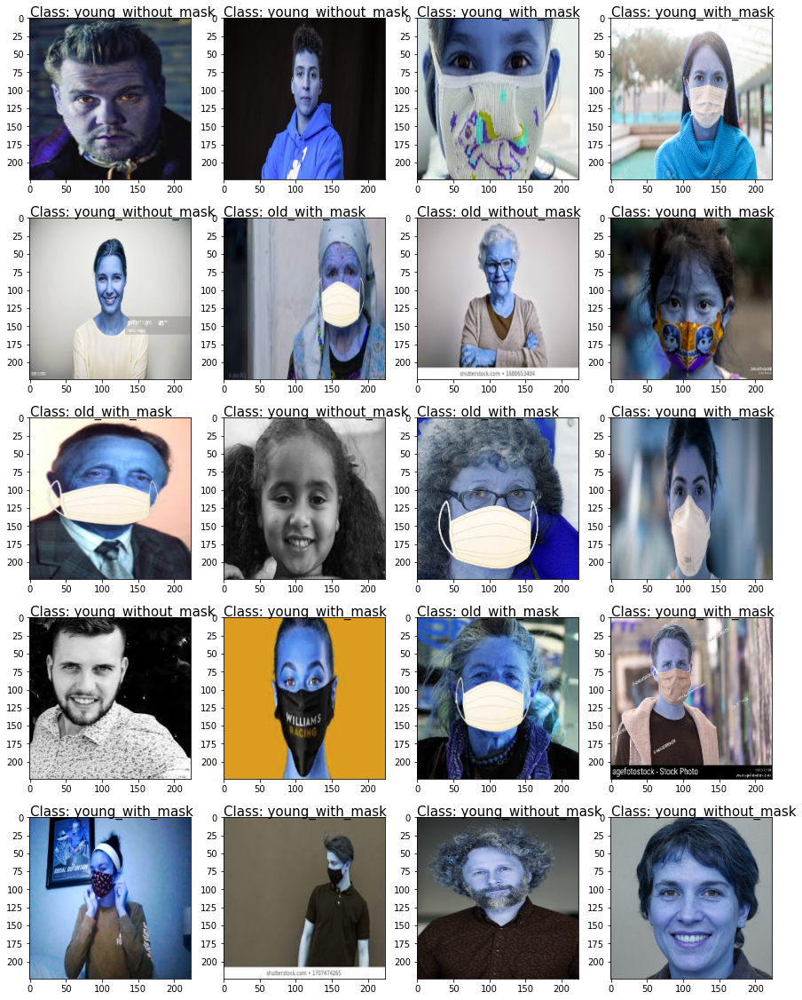

In [ ]:
import matplotlib.pyplot as plt

fig = plt.figure(figsize=(15,20))

y = np.argmax(train_y, axis=-1) # to return one-hot encoded to regular index

rows = 5
cols = 4
for i in range(rows*cols):
    # dodavanje na podgrafik
    ax1 = fig.add_subplot(rows, cols,(i+1)) 
    # crtanje na podgrafikot
    ax1.imshow(train_X_processed[i], cmap='gray')
    #  dodavanje na tekst na podgrafikot
    title = ("Class: "+names[y[i]])
    ax1.text(0, -2, title, size=15)
    

# snimanje na grafikot
plt.show()

**Image Generator**

In [ ]:
aug = ImageDataGenerator(
	rotation_range=20,
	zoom_range=0.15,
	width_shift_range=0.2,
	height_shift_range=0.2,
	shear_range=0.15,
	horizontal_flip=True,
	fill_mode="nearest")

**Model Architecture**

In [ ]:
# Load the TensorBoard notebook extension
%load_ext tensorboard

In [ ]:
# Clear any logs from previous runs
!rm -rf ./logs/ 

In [ ]:
# parametar search

HP_NUM_UNITS = hp.HParam('num_units', hp.Discrete([128]))
HP_DROPOUT = hp.HParam('dropout', hp.RealInterval(0.1, 0.2))
HP_OPTIMIZER = hp.HParam('optimizer', hp.Discrete(['adam', 'RMSprop']))

METRIC_ACCURACY = 'accuracy'

with tf.summary.create_file_writer('logs/hparam_tuning').as_default():
  hp.hparams_config(
    hparams=[HP_NUM_UNITS, HP_DROPOUT, HP_OPTIMIZER],
    metrics=[hp.Metric(METRIC_ACCURACY, display_name='Accuracy')],
  )

In [ ]:
#INIT_LR = 1e-4
EPOCHS = 20
BS = 32

In [ ]:
def train_test_model(hparams):
  # base model
  baseModel = MobileNetV2(weights="imagenet", include_top=False,
	input_tensor=Input(shape=(224, 224, 3)))
  
  # head model
  headModel = baseModel.output
  headModel = AveragePooling2D(pool_size=(7, 7))(headModel)
  headModel = Flatten(name="flatten")(headModel)
  headModel = Dense(hparams[HP_NUM_UNITS], activation="relu")(headModel)
  headModel = Dropout(hparams[HP_DROPOUT])(headModel)
  headModel = Dense(4, activation="softmax")(headModel)

  # place the head FC model on top of the base model
  model = Model(inputs=baseModel.input, outputs=headModel)

  # loop over all layers in the base model and freeze them so they will *not* be updated during the first training process
  for layer in baseModel.layers:
    layer.trainable = False

  # compile model 
  model.compile(loss="categorical_crossentropy", optimizer=hparams[HP_OPTIMIZER], metrics=["accuracy"])
  
  # define callbacks
  checkpoint_path = "best_model/bm.ckpt"

  save_model_callback = tf.keras.callbacks.ModelCheckpoint(filepath=checkpoint_path, monitor='val_loss', save_best_only=True)

  callback_list = [save_model_callback]

  # train the head of the network
  H = model.fit(
	  aug.flow(train_X_processed, train_y, batch_size=BS),
	  steps_per_epoch=len(train_X_processed) // BS,
	  validation_data=(val_X_processed, val_y),
	  validation_steps=len(val_X_processed) // BS,
    callbacks = callback_list,	  
	  epochs=EPOCHS)
  
  # evaluate model
  _, score = model.evaluate(test_X_processed, test_y)

  return score


In [ ]:
# For each run, log an hparams summary with the hyperparameters and final accuracy
def run(run_dir, hparams):
  with tf.summary.create_file_writer(run_dir).as_default():
    hp.hparams(hparams)  # record the values used in this trial
    accuracy = train_test_model(hparams)
    tf.summary.scalar(METRIC_ACCURACY, accuracy, step=1)

In [ ]:
# Start runs and log them
session_num = 0

for num_units in HP_NUM_UNITS.domain.values:
  for dropout_rate in (HP_DROPOUT.domain.min_value, HP_DROPOUT.domain.max_value):
    for optimizer in HP_OPTIMIZER.domain.values:
      hparams = {
          HP_NUM_UNITS: num_units,
          HP_DROPOUT: dropout_rate,
          HP_OPTIMIZER: optimizer,
      }
      run_name = "run-%d" % session_num
      print('--- Starting trial: %s' % run_name)
      print({h.name: hparams[h] for h in hparams})
      run('logs/hparam_tuning/' + run_name, hparams)
      session_num += 1

--- Starting trial: run-0
{'num_units': 128, 'dropout': 0.1, 'optimizer': 'RMSprop'}
9412608/9406464 [==============================] - 0s 0us/step
Epoch 1/20
30/30 [==============================] - ETA: 0s - loss: 0.9173 - accuracy: 0.6995WARNING:tensorflow:From /usr/local/lib/python3.6/dist-packages/tensorflow/python/ops/resource_variable_ops.py:1817: calling BaseResourceVariable.__init__ (from tensorflow.python.ops.resource_variable_ops) with constraint is deprecated and will be removed in a future version.
Instructions for updating:
If using Keras pass *_constraint arguments to layers.
INFO:tensorflow:Assets written to: best_model/bm.ckpt/assets
30/30 [==============================] - 59s 2s/step - loss: 0.9173 - accuracy: 0.6995 - val_loss: 0.3721 - val_accuracy: 0.8807
Epoch 2/20
30/30 [==============================] - 58s 2s/step - loss: 0.4238 - accuracy: 0.8540 - val_loss: 0.2557 - val_accuracy: 0.9266
Epoch 3/20
30/30 [==============================] - 41s 1s/step - loss: 

In [ ]:
from tensorflow import keras
model = keras.models.load_model('/content/best_model/bm.ckpt')

In [ ]:
# model summary
model.summary()

In [ ]:
# Visualize the results in TensorBoard's HParams plugin
%tensorboard --logdir logs/hparam_tuning

<IPython.core.display.Javascript object>

In [ ]:
# zip best model
!zip -r /content/best_model.zip /content/best_model

  adding: content/best_model/ (stored 0%)
  adding: content/best_model/bm.ckpt/ (stored 0%)
  adding: content/best_model/bm.ckpt/saved_model.pb (deflated 92%)
  adding: content/best_model/bm.ckpt/assets/ (stored 0%)
  adding: content/best_model/bm.ckpt/variables/ (stored 0%)
  adding: content/best_model/bm.ckpt/variables/variables.index (deflated 77%)
  adding: content/best_model/bm.ckpt/variables/variables.data-00000-of-00001 (deflated 8%)


In [ ]:
# download best model
from google.colab import files
files.download("/content/best_model.zip")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
# evaluate model on test set
score = model.evaluate(test_X_processed, test_y)

print('Test accuracy: ', score[1])

12/12 [==============================] - 11s 898ms/step - loss: 0.2561 - accuracy: 0.8981
Test accuracy:  0.8980716466903687


In [ ]:
# make predictions on the test set
print("[INFO] evaluating network...")
predIdxs = model.predict(test_X_processed, batch_size=BS)

[INFO] evaluating network...


In [ ]:
# label with corresponding largest predicted probability
predIdxs = np.argmax(predIdxs, axis=1)

In [ ]:
# classification report
print(classification_report(test_y.argmax(axis=1), predIdxs,
	target_names=names))

                    precision    recall  f1-score   support

     old_with_mask       0.93      0.91      0.92        93
  old_without_mask       0.88      0.90      0.89        91
   young_with_mask       0.90      0.92      0.91        88
young_without_mask       0.88      0.86      0.87        91

          accuracy                           0.90       363
         macro avg       0.90      0.90      0.90       363
      weighted avg       0.90      0.90      0.90       363



In [ ]:
# plot the training and valuation loss and accuracy
N = EPOCHS
plt.style.use("ggplot")
plt.figure()
plt.plot(np.arange(0, N), H.history["loss"], label="train_loss")
plt.plot(np.arange(0, N), H.history["val_loss"], label="val_loss")
plt.plot(np.arange(0, N), H.history["accuracy"], label="train_acc")
plt.plot(np.arange(0, N), H.history["val_accuracy"], label="val_acc")
plt.title("Training Loss and Accuracy")
plt.xlabel("Epoch #")
plt.ylabel("Loss/Accuracy")
plt.legend(loc="lower left")

NameError: ignored

<Figure size 432x288 with 0 Axes>

**External Images Prediction**

In [ ]:
#prediction function
def get_prediction(image):
    image = np.expand_dims(image, axis=0)
    plt.imshow(image.reshape(224, 224, 3))
    
    # istreniraniot model go koristime za prepoznavanje
    prediction = model.predict(image)
    # prepoznaenata klasa ni e indeksot od najgolemata vrednost vo izlezot (prediction), najgolemata verojatnost
    predicted_class = np.argmax(prediction)
    return names[predicted_class]

In [ ]:
# URL prediction function
import urllib.request
import cv2
import matplotlib.pyplot as plt


def url_to_image(url):
  resp = urllib.request.urlopen(url)
  image = np.asarray(bytearray(resp.read()), dtype="uint8")
  image = cv2.imdecode(image, cv2.IMREAD_COLOR)
  image_ = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
  # PREPROCESS YOUR INPUT
  image_resized  = cv2.resize(image, (224,224))/255
  return image_resized, image_

def predict_url(url):
  image_resized, image = url_to_image(url)
  predicted_class = get_prediction(image_resized)
  plt.imshow(image)
  plt.title("Predicted : " + predicted_class)

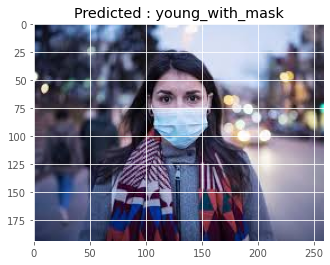

In [ ]:
predict_url('data:image/jpeg;base64,/9j/4AAQSkZJRgABAQAAAQABAAD/2wCEAAkGBxMTEhUSEhMVFRUVFRcVFxgVFxUVFRYXGRUYFxcWFRUYHSggGBomGxYVITEhJSkrLi4uFx8zODMtNygtLisBCgoKDg0OGxAQGy0lHyUtLS8tLS8tLS0tLS0rLS0tLS0tLS0tLS0tLS0tLS0tLS0tLS0tLS0tLS0tLS0tLS0tLf/AABEIAMIBAwMBIgACEQEDEQH/xAAcAAACAgMBAQAAAAAAAAAAAAAEBQMGAAIHAQj/xABAEAABBAAEBAMFBQUHBAMAAAABAAIDEQQFEiEGMUFREyJhMnGBkaEHscHR8CMzQlKyFBVicoLh8RYkkqKDwtL/xAAZAQADAQEBAAAAAAAAAAAAAAABAgMEAAX/xAAvEQACAgICAAQDCQADAQAAAAAAAQIRAyESMQQTQVEiM3EyYYGRobHB4fAUQvEF/9oADAMBAAIRAxEAPwDk2HbKRYJpe4E0/dT4fHaWltIVkZc6hzJWl0qomvUtD8SwNHqjsuYySglWDyiqLj80S+Twz5VqUvVkXH2HMmBYzzBF5Q8a7PJVifNCTRWNzTehsj5kRPLbWzrLMfEGetKmT4UTzF1daRmTYtmi3GypMtxjNbq6FPoRKRYMqyaJjSSBaV59MwNIaE3jx7dJJPRUbPMyGpwB7ocvVnKN0it5hiWhztuSQSxkku7o7GU5xJul62VtUOyyZPi7NcVQPg8MHK98E5JMJA5rqZ2VA8UtPYro3BPFQGljqB5I4XH8Rcydfcday0llH0TH+8P8P1/2SvCTa2gqcBLKKb2GLpaJCNbrPVNIYg0UEth5qZ7jXNRnt0WitWe42Q3pvZB6VuV5SrFUiT2zWl5S3pZSawUaUvKW9LwrrBRqtaW9LxE4jLVq4KVauCIKBnpXmg8tlM3uAPNIuK5iIiR2VIiPsrmLc12wpIM5BrR3RGX4wOq+a9zgt2WSXZsj0JmZfsF6m8XIe5Yuo7RXsywLGs2ASKI6HNKKxWZamgBBSOulbJJN2iEE1pliZmAIUE+JHP0Sd2KoUFo2Qu2Cm5WOkESSWU1weA1AFJ9G4Vky3EiMb9kUcxxFw9O2Iv2G10Sbr5KThrC6rJTKbiQPioNokUTfzpVqPNHxtOn1RjfqKrCeIsc6N2lpO6qjZXF1vPNMsua6d5e88kS/ANMoZ2R29hFExDvKN1jcI0WrdiciZHHrHOrtUPHY3zmkZSS7AlZtjIhYITDhmJpnZqOwNpJ4xPNF4O7sbUoqXxWO1ao+icqxzAwbjsmDMdGTWtt9r3+S+epc0mAoPd86+vb0QeEzdweDZBHW9796vJpsmotH0yyUd1I5y+fpOMMU8giWq7Orl7grBkP2iYiNwE48WO+fJ4HcHr8Ujhu0PeqOvL1CZZmMc8YkicHNPzB7OHQ+iLQFMXi9WLjjxeEL1eOKJxqtXFbEoXFvoWmQrJwV480FWJM+EbvMvH8WRHYOCbgwJ2LuLc4dC4Fp67oYZu3FR6Qb6JJxTifFdfRecFgNNHuuWTdFJYlSYfDk7Wbqs8Qvp4o7K95pMyua53nsg1gg3ulyVQIWMsNjAGt9yxLWYoUNl4pjlZw7O62dGrp9ofA5y7w3CTxGyAi60kOHPbtuFUzA7RYBPuQi00cAujpE4VwC1Z5tit3kBA43mlpbR4s9UO8clN4dhMrAWPAYgFlLaGLxDpASjLYyFa+GcOdRdWyotg6QvmAwrd+pSn+8iZdfcp3xaA9wb6qrZizTy6JZaDE6e2RskG55tXL84wQY5xHK0VhM5kDdIOy1fh3S7lCTUkctCiCO0YXhu1/X8ei1dH4dk7VyS1829qS0OMpZXd6H66c1tO3SxjqBBvf1vkUbw/kkmJI2po68lef+l2iMMLQR+t0/Kxo420c6jcDzr5Ilklf8pw/g525YS2unMe6kpzPI54Rbm23uPyR5+4HiY74a4hfhZA+N503T2E2COxH3Hou4ZTmLMRE2WM2HD5HqCvmCOYj9fQroX2W8ViGb+zyGo5T5Sf4X9j7/AMkeaYjhSO0rxeFy9BXCHjioJJFO9AzsKdCtm/jIXGTeUrSQOCSZpjtjSpGJNyK7nTrcQqscC9ji7oUyzDGEPTfhnJX47WA8MayrcQXbnkALHZZ82RRtyZowproq805PNTZPOQ7Yq45t9nrWRkCRxkDbBNaHHtVWPmVRMJC8DUFnw54ZW+L2uzTkTSQ3zORxabKqGIl33Vnw8T5BaS4/Ceeuqu7IgH9oXinOGC8S7DQ+4941dmUjaZ4cUdhjSbcb5ucRtZobDssxmUT4bDNmnhcyN+zXOq7IsW3m2x3pIcpjDHNlc3U1kjXEfzNa4Ej4gLov2pcZ4bEYQYfDv8QyOY9xogMa06gDY9omtulG1NylBpRR3G0c0wEjXOcaUseX+I/blaXwYc9E/gm0NG2/RUcr0TnaWj3Mcva1oAq1mQZdrkp42G/vUckpc7zcgnEArdhoqyhojxaVG+dYJjNOgV3T/JJmMj6clWsU8k2TaNwWDeW3eyCj0hqqGxHxFi7m2SXMHEhNM0iBkHvRE+V6m7C10ldlF0V3DKwZG8O2PRCR5DJzIIUTy7DtceRI0hJ9kPYDxFigZS1vJu3xQ2S5cZ5ms6cz7kvLi522/VXv7PMOGtfO5pPm0gNFuNDkB71PspFbLzkmXhjQ1opo/XNWAM2VPx3Ek0B/aYQhvQteHGv8QaDRROS8WtnsNBYR/C77/UI9Gi0ywtwfP15rzEYMFuk0RSgkzLQCTyVdfx7HdMhkcbrfYH5LmG67EnGPBukGaAermjr6j1VFDyKI58/iORXdcDjnzt/aQBgIsESNePcQNwuWcS8OyjGyQwRl2r9o0DYAEWQXHYb6ki0TyL1R1HhfiYywse4/wi/eNj9VacNmLXDmuG8B48gSRHoLo9DdFWbK8/cyTQ7dt81pjO0ZZQ9jqn9qC8GIaq3HjwRfRRSYgk7FMgOJapdJCqucwgWVFJm7m7Epbj8dqHPZPGSROWNsrGOjuUqzcIZk7Cv8rQ5slBzbrlyIPfdVwuuS02bIG6T2IKx5ammmasUaaLXxdnsnh6o2hoqt9yL6hVnI8p1QAkdLUXEObgxae5H5pxw3iiYR7l59+QrXr2bVFSVCjKKY5zHDqeaq3ErtM1jlunHErXxu1t96q2LxJk8xXoY8nKNmTJDi6M8ZYoY6pYnEo0hkIaWlRyNFbJliIhWyFGEKWwtEOHfRF90VmM90B3tC4jyc1FDiQShdnBTZSiDmBAUbWAqePBF9BvMorIc4Wa4HFF59FbnZ4xkYHpVJXFwzJGzUqjmhcH9U6dE5QTQ2fLrffqrnw81p5qkcPYYve0Hqr6Mu06N6sgJ+S9TuDa0O8dEwMJ2XFeKsx8WZ2n2GktHrXMroXHWaNih8KN3ndtfWupPbsFyWTsFOcrVI6MeIZw+0mcAEg0dx6UfutdO4ZypwwgDPa1OO+3M7LnXDjxHiIT0L9J/1Cr+v0Xa+EpG4iISRGm/uyCDYfH5DsOVgNd/qSxVlYySWznOa5ZiiHOcXOcHimggW2juHEEAg6efS03yfI5A0Eu5BpPo+vMAe12umPyFrtzX/AIk/ep2ZCNNa6/0j803EbnC7srXEmVF0DQ2xuLrtSoGbcNSUNDhqJcHai4CrGktNbkUbHLdduflIoAvO3oPzUD8hjJsOIPoW0fha7ic8kHps57w5kcjXkskd4R5B3MfHl8vqieOYPDhmmBIOhg2JF6BKaPp5gugsy5jRsT8wue/ajmDBDLhmXrEbJHXyIkl8OvfTSfil4h8xPSOUcM4nRMw9zpPx2X0DwLhIRhgWhpcSfENAm7NB3wrZfOWD8rx7x966fkmNdFK6nEXXIkbV1pZfEYpZFSYcTXqdYzDLoyxzQ0BoBqgBpNdK5KotwDwLVqyXMY3wtpw2FOBPI9bv52ieH543ulLKsO2/y9x6K2FPHEnOas5JnmLc12migsRO/R6LpvHmUtkc0saC4tJcAOx2NDrz+S53isG+nNqq7qym2KqYrwzrN2jy7UQAtcn4dnlGppaOwJNkd+SbwZO4HzbEduqVQfYykroU5zlmlocTY62jsnzQRx0ByCn4igfIzw2DzV3ofFKsmwZhaWTe0O+4I9D1WSUefZqUuLpAmf5x4gIA9AqjJIRsrkcofM4+G2xaQZllzoZ2NlbQLhfusX9FWDivhTM2ST7AGYWUiwxxHoCsXesswMZiZTW+yOgWLRxj7nhL/wCpme/K/X+jjTGWjsOANlAw+q8mkLd0h79rsXZ9hS4+VBYPK3agncUus7ouwEygybasCfhS2kRgMYInanKeEajuq9nkvn0hJwakFvVl2xPGMbmaQqdinNe4uQcDBS9Ma0mZybLBwu8eOwLoPER0wW07hcqwLzGQ4HcK4RZqcQxrT62Om3L6lTyaVl8Tv4SmZ9K+Qlzj6/DokUbNrVrz6EBrz1J+QCrzm00eqlHY01TBg6iN63+R6H5rqv2UY572YimAeG6MnSDRJD9RNnnt9y5FM7ddR+ynMxh2yRSOY107g9moOJcQ0gixt2NepVcT+NIjmUvLbR1SGUkckRG5x5V8kBFJKW20ROB6+avoStP7wmY4B7Y9JNeXVY+ZWtxMKm62x4H3ta1c1w3tLXzm9q+v5ohzpTu14A/ygpHGiqnYQ4kjYrj32rMc3GhridLoGPb2JtzTv3Bafn6rrMoc0W+QknkAGAn3UFxf7Q8+jxWJYIy5wiY9mom2kl1+T08vPl71Oa0VxyfKinCG5mgdSPqaXRMNCBLR93yVOyWEPxcLXdSz+pd7yPh6Jup5a1znE7uAdQvYC+Syt07NcdIqAymaUhsQ36f7prhskxEBtzy11bEGvkQrbl0UcMrgNg4fLrXoFLnji4NawXvd9OXQ/rkhHNzYJKpdaBOH3W1xe7U+9yTZI6c1VON5424jS3npt1d/zTh2Ak5gkH0sJHj+GZHEloL3HfYElUc1HZ0cdv2FOU8SMi8r2u7ChfLlat/DbWTM8Ui7LgL6b9FzHH4NzJKeC1wNEEEH5J7knEDoWkMcK6jnv3Cr8U46YmWKi9FuzTDMjc4nlW/oubcRY/xJg2O9LdrqrtNsdxE5xIN7pPiMQy72U1hk0wRnUi/8Gwt0gHnSW/aTlTSYXAfxj6qt5FxMYZhfsHY+isPEvEDJms0m6IK894pxydFpNMtGAwYEbBdU0LEtw2et0NvssQ/4syXOJy1jytcVJ3UkA9ELmLl6dDSeiCU1uCpIJC4jdK58RtS8wGKIdujYllj8foFWcwafFspzhJLchc6oFcwvoXMk3RTHoCI7o1q5Ej18yd8NSEkgc9kiMJcaCsPCdRSgyENaOpSy2imPUkx9Lw850b3OG5Dv+FzTETEg+my6nxDxvE2NzIPO43vVNG1XfVc1yjLnTv0iq1CyTQ35C/VIovovkafR7w7lPiEyPIaxm9uNDldC+Z22CbZlhXOLHMDmtFlriC2iCOV9QU7wkUUbSG6JPDoGaQf9uwmwWxsH7x24rodPMLXFxam6wTITZ8bEnTEP4T4UWxO9Dl0F77p/LraeykZJQ4NafZaOFc8M8bTs2cW12k6PELTVgcidr0/JWBjZH257SCO9D5LlORTVF5avUbruTdgdOitGE4tIbpnL/Rw3+Dt/qtWPI6qX5nk+I8Om28fXsXIY4DaifjS3izWxTXAEdOZ946D4qrRZ7C4c9u9ivvA+qS5vxEXgx4YX0LwP6TtZ9eXa+arJxSIY8c2yb7QOMtN4bDvJkdtLIDZY0/wNPRx69h2tc6a6nAjpX0UUgOp187N97JN3681NF0J5V9yxN8ns9GMeKpDLDOLJopm76S0130uvb1XfMBmodGJGHyuF/wDPqvn7kNhbTzHX3jsU+yDiWSLyNdY7O/JBxRSL3s7VleMa+Zodyvr7tr+NK2PA6rimB4jY4+cGN3zCssObzvYfDe57QO5+S89RlibVXZomlOmmWHFYxjXEA8inOWFpja5u97k+q5RiMTibNgIvK8VjOTXFo60SAVbpJpCSi2NftJy1kr2EAaw2nEc+flv6rns+QPadrV9bE/8Ai59Vs6IdlojpCcUcyxWAlSjG4WQb0utTYNp5hL8RlTD0TWdwOXQOk1AFqK/tGjnt1V3kyZg3AS3F5GD0XVaBxKkc5k6WsT3/AKfHZeprkT4L2BG4g9AlmMlslFSY1oFBABhdblzOFjzZpaaqUkmHNmlqcO49Elgoa4B3Jy8z3cAqTBwkMUWaAmPYckfQYVYY7ppEAlOFajmzeaunWufuXIWth2mheukJNOP5iVHIdR7WvJG9B8T0XDHsTDI5rG7aiB1NDqaG5VvZl2Hha0vY8G26Wn99Mb5aB7DTys7m+eyC4VwRoua8h7xppg8wZtZfIf3bT1rzVyR+FfuXQ+YgftMU/wBlotxIivmNqv6BUS0Ugg1plDAXxwwtZYDpDbIwSAfCjPtvp+7jsSK2IQWMl1EOdFNMHEa5JNTfKHAOMUQ9kCiO4sc0Rt7baqgf7RifZAJ0/wDbxHai1w35Gt91rhpHOaZQ57ptUcjC/Zs0NtsBvQatRrpqaLRY7/3+/wB9BVhMbDGXMAIpxonk+3OcD79JbssxGPjdsAT8Dv8AFbY5kXj64g5rZHlxY5pFECiASOYdqBHpaNzOcwtaREHBxDdtjZHlv0PRMr4mXJqQnbCHG2sPoSKWsWFm11Tg0cnXtz26p7DNLdHD0drDnDkeRFCtwDyXk+PAu4pA6jQ2cOvUfiiooTkylTN8775l5I9dz/upMM3+H4hNMuyN2InbEHBpcHusjby89h70HNg3tjEhrT4hjBHtBwF7j3KFUzUl8KYTLhDHCyZp1NcS1w/kcOQ+W6BnjBGpqsHDn7US4V1XKzU2+krPMNj3FhV2jG4itt9j9y5gkvUmy/FkOGpztI577hdP4GzR0Tg0vDoXuo3zF1TwfvC5aA0+Yck/yHEuhkDSfI/r26WjFJqmI210dzxOAb2ReXZeAOSByXG+LC0k24DS73jZPMK7ZZJJrTH5WhfmGBCTy4elZcaUmxCMWGxTJEhJI00ehpWqqZ1iqRiFkYmUgQ0jU6YrYvLF4ivDWJrBZzDGRNA25ryAnTpAUuFwLnblO8LhGtRUWxdFYxFsO4UuGkB6JpxHhQWWEmyxlBVhh5MjPLxGeGbqNAJ7hsobp8wQWSxi7Tt822y54+LKxnasoGd4URy+X1QbSdO1C/mfQBH57ZkI77D5oeUtA0sb03Nbk+pUmjrIIB5he9nl1KaYfAGUnUQxrG2ezQTt7yfwW3DWWk4iNz+QLiSegDHH8E7xs7IIma2h0kxdKGu2YKrRrPpzruhGOrYVt0jSSW2AElkBoMjaA2WfnRI/hZsOe3W7RQbKAHPMTPCFiM7xQU0EGTq99D2ee5O4QMErS5zmSanneXEcwzYeWBv829Ct9+q9xBjadMbDK8HUGOJ0MN6SZSD55CSNhu01WycuQY6QS+yJJpD5fFksNJOoBkbRs3U3k6qIHK0/mjHgBgd+yLmvw8gBJhkDhqicdyB8uRHQKWTI5WRj9rqklfG8+UeWRluGmh7HlArp5j1RU+SuMcznBoZNGXSxEkhsg38SMgEA1e1c63XUK5pgOYNfMx3kY2egZY+9OoTxnarI3PLcWTRQsEZnjbGd9WltHavMCLB7JgwuLYmSPp25w2IvY2K8KVtUfMGWN79K2TYubwhNTdJYH+Wy0tNbtaRuKs04dgng+yWdaTQ+my0xSaQ8uunaiACAS/y0Nq7KKaIbjYc/iOhCCyLFl7DeryktBe8yO5B1aiAa8/JMnn5Xf3clZGPYq4e2zCMcvJL/AEhL/DJwGodMcPuATLI6/vGL/JJy/wAoQsNf3bMd/Jjgfqwfis0u2eniVwX4fuwPiaEskixTLHita8EdHtoO+NafkUFnsFPD9qlAkaRyN7/A3eysmMjEuFxUHN+FmMjR18N9uI+Tn/IJDO3VDoJvQNcZ/wAPNwHzUZviPDE5xv2Ebm1de9OMtxLXxgHm2yPcl/hbBw+I/FS4Bo0FvU8j6jp8vuQi9kZRo6rwbmZaWhx2eGg/5q2P67roMM1LjmT4g6R3AAPvC6hlmK8SJr+43942KOeHUicH6DDEzpZNKpZ3ICV6lFFDHuQ8hXj5FE6RVSBZHIUM8qZ5UEiIrIiVi0KxE4p4cANl62RCNcpAVqohyNcyfbCleBiTPFttpQ2Xs2WjB2Z81jTLm0mcaXYdqNhKjN22aMcaQixGHvE6ujAT8eQRBjHYfq/9lviGgOJ77/Doow49ClFfYTk+H8TERxdHF2qv5Q1xI+PL4o/izhj+0S6hLp0sDQ3TY6knn3Ki4XAGKYfR5J/0HdSs4vwz3G3lh1EeYGtjXtDaksq9SmNyTuJR84yWXCOaXEEHdrm2Nx9x3WmW55LE4EU4M9kO9kO6OIHtEDlfdWjPMvdjJ6a8CKKNpLhuC59u27nTSlwvAkJY0mSUEiz7PXfkWqXF3o2ebGlzPeD89xGIxBEr9TWM1VpaKJOnah2JVh4j4oiwzSwgve5p8jSBQI5uPQKpZVkk2Hx48EufG2tbjTRpN2077nkdltLwXiZZHSSSxhzyXH2jz6cunL4JtiVjc7b0WnJckYYSwuuGRrXeGRYY4t3Mbum9EbbVtSr/ABlhPCJaXarhduRRIDXAauhIAaLFchsmfBmcs3wz3aZY3OZRPtaSRbSefLlzQ/2gytLmAEavCksWLALTuR25oxIzbppgXDJtp9Xcv/jYm+s0Ony53v8Ah8kh4TfbCP8AFXr7DeR+ScSSbH7u3P5q8ejK+wDCy+HifH5mMOFHYURRP0Q2XyCTBzYcbeJN4hd/Lu0gV12aoM5n066/j2+ptBZHidMmno4V8RuPxWTJGVSaPRwZoLJig1339b1/vvH+AxunMHSEHw5WGOUc6AY2ifeRXzSqFrd4r3aXaT1IBIH/AK1Y9VPO6pr7tH3lJpDc1g6aeSD8Vni3kTT9Dbma8NKPFXbqgLxC06exI/ApjgYDfuv6Efmo4IRJq282o38+nvRcJrUd+ZHzpNB3KjJkxOEbHeWPG/TcH/1V+4OxltfGeh1D3Hn+C5xl5ofrorVw1idMwHfy/r4gLVONwoyJ7LvO9Lp3KeZ6Bles0UVZG96hc5eSOUDpFSgEjnqFz1o96gfIjQLJS9eoEyrF3E6yoMUrShmPUrXq9kOIU1oOykfgtAsckG16bwzB0RBO4TRyuPQfLUuwaORTtkQLXKR0lApLH6I5nWSf1+uSjjduVGXb86Wauf6tORJocb4b3PG2mKUjfqYyB9aVLDPLab5o8kaR1ofDmUA5l0OnVdHF5lv8vr/RWOXy6X5/RGsGJlYaY97dRF04i/eL32TV2bTMGoTSenndz+aXMb577BD4ma77DkrKvD45Ptt6Fd+ImvZLZasBxi+OIW3W9xtznGgeg2bz2CKHGeIvZsX/AIu//SpkprSOwReGksD02TeHWN5HBr2/sTNGSxqa+/8AosWUZE/EynFmRsdyl1NBJDgb6nbf3onjXL/Dl8fWXGYPFHk3THsGntskOGz+aFj443Bo1XyBNkDuocyzeWVrDI8vonnWxIo8vRQyYlFyp9b/AFotjyTlFJ/T9LHPCp8jh01Xt6sb+SeOf2P+3Lt71W+HH+V1f4f6FYAbB/XIb7fmug/hM8uxDn0TnPAAuh6fX6pY2CQEENdsb5FPcZJUjd+YK0ml0tLiBQBPb7lky5nGTjR6Hh/AwywWRyaYLjcYDLFW1tcD6HY6T680qLiXn1J+9BvxB53vr1/Gjf4fJPMlxLS3YAOHP19VGMvLvRqy4n4mSXKvX9hdhcWYnkkH2jqHWtvqmskg8Qgbg04V1to3S7P46l1D+NoPxGx+4LXL5dtzy2Huu0+KPJ8l7A8U+ONwfuWfBuHfomeFn0vBHQg/HmkeAkvfbn+tkYx9EfBazzEdGGIsX3FoeRyW5di7YPTZEulUONMrZ5I9DyOWSOQ7npkgHr3oeR62e5CveiAl1LEPrWLjrKiHqZhQbJApRMmECtS8i1XsdlCHqVkiFWGw6MLzEO2WkRQOJcXOKdaFbJnPFqN7vXuh9KjlsA/r9dUGwEWJYTuPVC8kXHJtfr+NLaQAjkEuPxvC01o1vwCnFNOmL3XoLuhOn80Md6Hcprj21DXYhLMP+8Z71GWZzfJ9FvIWNKK7f7mPdZJUmGlo/C/ktMTHpcR8vd0ROUst5voK+f6KKzOMvMXZ3kqS8t/QFL9z60Vu3cafiocQzS+j0sKWD2h710cm7fX8A46aXf8AJYOHJKDq/wAPzohPmSaSL5/l37qt5eAySVoO3lI+LbTcyjb7/RaMcvhPPyxak0wHiCbQ6N3Z5+IN/haHzzEeQN/mP0G/5LziR1tHo7bf4JTink6bN00D5KGXG5S5exv8NnUMfD3BcR7PuU2DxBY4OHxHcdQoZeRUcLlF9j8qlaLBnLg+ON7ehoe4j8wEDhXc1FE8lhbe1h3xR2SYB00gYzqLJ6NA5n6rV4fE4rk+t/l/6R8VnU24rvX5r+hplz9v13R0b9ylGGJA93MfejI2mkUZSz5ZPsR8UcJlWcveQ4b2CE1bOgxkMXSqCRyH8ZeOkQCbOkUMki0e9QSPRBZJrWIQvWLjrKupGLFi4UnClYsWIoAZGh3LFidCyIHn8UFjDssWJJhQO8/sh7x/UiW8x7/xWLF58j2ofwjMx/dn3j7wlmF/eN9/4FYsTL7ImT7aCc15j3fit8m5u+H4rFi7/qFfNIM7H7Qe4KCPmPeFixPHolL5j+o4gP7aT/T/AElHajpG/X8VixacX2EYvEfMl9QPOvZH+b/7JXPyCxYrr5cyUftxBn8ioYlixYDc/tIPwvVdA4OYBhwQACdV0Oe/VYsW1/Ij+JjfzpFXgPnPqXJlh/ZHwWLEkQPsMj5hEHmVixdMMT1erxYlCzSQqF6xYiAgKxYsXHH/2Q==')

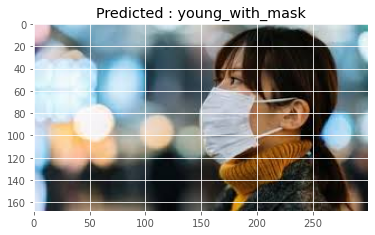

In [ ]:
predict_url('data:image/jpeg;base64,/9j/4AAQSkZJRgABAQAAAQABAAD/2wCEAAkGBxITEhUSEhMWFRUVFxUQEBUVEhAQFRAQFRIWFxUWFRUYHSggGBolGxUVITEhJSkrLi4uFx8zODMsNygtLisBCgoKDg0OGxAQGi0lHyUuLS0tLSsrLS0tLS0tLS0rLTItLSstLS0tLS0tLS0tLS0tLS0tLS0tKy0tLS0tLS0tK//AABEIAKgBLAMBIgACEQEDEQH/xAAcAAACAgMBAQAAAAAAAAAAAAAEBQMGAAIHAQj/xAA7EAABAwMCAwYEBQIGAgMAAAABAAIDBBEhBTESQVEGImFxgZETMqGxBxRSwdHh8BUjQmJy8YKSJDNT/8QAGgEAAwEBAQEAAAAAAAAAAAAAAgMEAQUABv/EACYRAAIDAAMAAgICAgMAAAAAAAABAgMREiExBEETIhRRBWEyQoH/2gAMAwEAAhEDEQA/AOopdrTx8J3kfspHVYsket1hLS0c1nf0WSxLsrum6q5p4XbXtdWelqwcg3VPfSkHIWR1ro9tuiohdnUjkWUp9xL3+eQ81cq5BrbXeBW35wFUx4vwlbkvRhNLdaNYho5Loxq80eTPQxa2yvJHrWMLGg9DKdyZRyJZA1FhJkOiTzOUcNYWeSHqJiAkFfXOHOyA1su8Wtt5uW8mtNt8y5kdTccXWQ17r7rx7ky/y1hepoBZVahrHdU8gqCeaBjIDMuQcxXoevBlLwoSF9U2/JV+tBBOFaqhwCU1RbYl1vVe4IxyKtK5Cv1BsWXEAeOEu7Tdooo3FsOXbeAP7qmzOkldxSEnw8FiZjhvpfJe2lM3bicf9rT9yh5fxDI+SL1c7+FReHP1/gKK+fqUWsHii8N/EGa2eHysceqOi/EQiwDL4yTZc34r3WtyvazXFM69QfiVDe0oLR1A4vomUf4l0YIF3G/gQPc4XELrxy9yM4H0npHaqmqB/lvBPQ4IThszdwQvlygrpInB8bi0jofoeq6Z2X/EVuG1I4dgXC5A8SOQWcuwuHXR1yOZFslCUUVUyRoexwc05BBBBR0Tka7AZJLKEp1F4sj5ktrHCyfXEnsl0VSpf3lKwvt8jv8A1KfaBpTZHl7hcDAG4urk2ADFgtm0nhMvjuzvTkmn9onS4AKe0dE52XIXsp2fETLvy5W+CABZNKPh03N2Cs6ULZVZ1/SOEcTPUK/SFBSUwd8w9LKac2wo1pHI3xv3APsURS1Z5rqLY2NwGgegVd1/QGu78TbO/wBQAw4eXVbTb3gu6nrRXR1KZNmukbYi3BBB8VIycq1MhcR3xL1sgCVtnKlja4osYPJIcxyqQ1NkAyncAhqqUgJcosYpoJrdRaAqlquo3NgttQrVX6mW5SxgT8e2bqQVnNAsK2K8zyHVJrfDy+yd0naHwP0VGc5FU1QlsdD0v7O0F+X1TCj1HibdUOGdONLrgDY7H7paKMWFjqKjmVzLtl2qLiYojgYJHNWDtnqvw4e6cuwuYwQOkeGjJP35pc5d4HGPWmsERd3j/fgPFP2ab8OF0rxv3R52ui9E0sPlDQLtj+rgbAnzIJ9Ed20IbGxg2vb+qXz7D4Yig1DuSgb/AEREjefsoA3+E1MThkbc+hWNTCSDht1GEE4ZXt084nj2rSylaLi3stPH0W6ZhGBlSsPNakLL2XjxbOx/aySkkAJJid87d7H9TfFdjpdUDgHNdcEXBBwQV86N/vzXSPw71TijMLjlty3/AIn+Eyp/tjFXpqOo6PNWG25QD6glRvkxZaluFekkcty0snZScEEeKs91zrRaz4UvgVfoagFoN1NYtellLSWAlJSNaOpRTo+LC8aERC1ekw4gbILG31UzohbZTBuStixZpvbFUlKH7jZa8FsAbJs2JQyixRRktBknhW9V0xkrTizuR6qmupbEjphdNmiuPFUeuj/zX+Z91TD9iO1uKAqSludlYaPTwOS80el5p/FCinPOhdVfLti51MLbJLqtFjCtj4kt1GHCGEtYdkMWo452hBY5Jo33Ktfb2ntYqpUu6VbHjIdTLlDWGMW5W7I166NLY5AkpWsT1JMEPGUtoZF4M4ZkTDOUuiKIYUODeXQv7W1RJY0nYcSl0WhLITMR3nnhjvvbr+/oge0zLvjPUWT7T2Pe15fn4UZDANrubYfS6iteF1XY97PRtZHyHEeEE/pbgn1z7qudvZh8RjQbgAm/Uo3StM4w1z5CBwiwBOCcnySHtfThkgDTcWBugg9Yc10V6QryJuR4ZXiYaPT8TneAH1VDeEyWsinluShJOaNrqYtJQEjtj6LUDLUeNK3I+qhJ/lTjI8s/yiYK7NDstHBTOG/utHt7t+izT2HsJTzsrVGKpb0J+hukELsppSGzmvG7TY+6zlxkmEo8otHX4ZLlEvdhKqKbAPgjfiLqp6jiSjjBaiSxRsHaR7Bw9EtrClks4ulP0NHcmsUrTZBni4iBstnA80pxKFIKjClshGFyl7yFxGxfRNyQ8jFvF4rJLrF0el2gCd/CqZKLyv8A+RVq1N1mn9VjbzVU04G5vvfPmrql+unNvetIsWlRYTdrUuoNkyBSZvsqqWI0c1LdR2TGRyT6nJhbX6es8Oa/iF8o81UaCO5Vr7dm4ASCgjRW/wDID48f0/8AQyKNeviW7QpLJTKME9YyyAandfHhKRGgCw3jep2PUIjTDSNPdNKyJu7iAT+lvN3puvHhfWUEs5axmSfkAGb3A39d1fNK0dkEIjceN5H+YdwXEDA8Bt7q2UuiQNFmMaO6GXHdeW+J8V4/QBuHEeBF/qFHbS34X02pLs5hSaGDLPLwyMbe0RaXN4nBzruA2tskevUstuJ7SQDYOtYkeIC7J/ghGT3reJ+yV6nprSC17SAeoskvkvodHjLcZw0swT0Trsk0Oc8eAP3TbWeyLmO4mXMbsE/pKUdnQYar4cmLng+uCilLYsFR4yG2r0I58/4VMnZwkg8sei6J2oPDFcb3wqLqMdwHjngrKJPDL4rRaVvC9arUFUEyYc4fUEfwoosghZA76fZeAWdZCM/2RMNimtNu5vUX+iUy7pnRG5Yf/EobP7Nr6eHRKKo7jT/tH2RIrbJXCLNHkPssc4roQl+qOXZH92F1VfhI5p8oqYJe+PKzkDwPpEnKkblCNcp4HbrGhqJmKQlDNfkrfiQNBRZINkNNKQpWvXv5e+SvLr01py8FdSwOGVUonWkd/wAiuhtp2jxUM1ExwsWNI8gmL5Kj9CpfDc+9EFHMmLJkBqOn/C7zcs5jm3+iijqhZN6muSF/tW+MhjNKk1e+6mlqEvmkutXRr7Kh2m09zyLZSWKkc3cWV6qI7jKWTwhKk9ehw6WFfaxSBqLqYQhSUDY5AlSy6B+Am7mXQ7o0GhAAiXRexejfAZ8V4/zJALXH/wBce49Tv7Ks9nNP+LUMbuB3z4hubfZdLYx/Mj7rdPJG7bKRrulx5E/YqNrXdR7LbjAwtCMf/d1BI2+Le+R7KYi61sevssa08gCtiY2J1+BuLC5DW8R81Qda7LMmAe2eFkjbFrjILYN82Vl7XVvE9sQ2aOJ3i47ew+6Rm1tlzrrUp+HQqqlw3RdqVDBLHwPr6drhh/CTJY26Cyr50egDeF2o8Vv/AM6Zx+7ii9V09pkLgLXGbdUNTdng6znNPQkEhbG2KQMqpN+iyWk04GzHVUx5ACKIE+oRDuzlO6wdJ8B5yGkunIby48ABWiPQYoGGU2HDm/8AXmUXokEUznuAHGwkSA82n5XDwIshle/oKHx19nO9a7OS0tnEh8btpGbZ2uOSWHkV07Umh0c9O75Q0lnQcx7ELl0Lrgf3n+7oqbXYnv0ZdUq2s+zSZG6Wb8I8bIGY7p32QoTLM2wuGnid7YVHFyWIm5JPWXqOLujyH2Wjo0w+AbbFROjVT1Ij1N9ArKW63/w4dExhZsjmUTiL2WJAyOlwuDhcKKerDD18kO6MjZQGK5RSeLRsYJvBpA/nyKkkeLYStrTyWBp6rnz/AMhCL8ZVH4Tf2hjQuu4jplMUk04WcU4jOFtXyfzd4bOlV9I2XiwrwqgWQVbAWkHYiyoRqOBxb0KvdbLwsJK5zUgue5w5n6LabXGTQr5FfNJh35m62blCwjqj4GhPdmkygzaChL0c3Ro+Yuj6aOwUpCjttb8L6qUl2V+v0CNwNhYqoV2nFjrELpb1Xe0dOOHiS4WvcYdlKzUUx8VkFInopS7ZejQydynuSJ8IexZ/+QT0Y63qR/Kv7W+KqWi6cYpeLcFrh9P6J/DRXHE6/wBUVb081ngXIB+sIfu3+b2uoHxuGAMea8DT4el0wwMAx8x9lDNWcNuflheEm1rrPy7bXtc73JwsbNRUtUJfM8+P0sojHhMNZg4ZibYcA4cvA/ZCFce1ZJnXg9ihVNT3KNpowBZe/CN8Zvy3+iL/ACksY+K9oawA/O5rCfIHdCotm6kKqmlnluxwswE2AItYbeaJ7N0nw3OwR3S0+4IU0Oq072nvNF/FL9Q7QxQNw/jIHyt5oU96GZnbFvausEMDyfmk7jB1vufQXXNYCjde1aSpl434thjRs0dB/KBgGV0Kq+EO/Tn3W/kn0bPjJdYC5Ow6rtvYPsuIIW8Q77rOeT1PL0VG/DbRxNP8Vwu1gxjc/wDS7bTx2C6nxYcY836zj/Lscp8F4iN2mNLcAXVZ1ihtkBXeMYSftBCOHi9D7JjfLpkzjwySEWlUnFYlXSmo2hoFlXNJADgFamHCnzC2PfZLI1DcQ4kW8pVVPs5bOOxYUZ5NBzVshKaW6LBXzc1yZ3EsQPJIWuBCaUlW13PzHRKp25Q/DYpVdk6pdeDJVKxFoutXuA3SSGdzRg/uskmc7crofzevOyX+I99I9ZqS/ut2+6rbocqzOYLJFWd16Kmxv0G+tJdHjYVLG2xXjJlrLNZU8yThhYqZ+Fs5yRUOpgYJTI1bTzUs20yuGNEr3JH2gmAbbqptR1iOMXLlRaztB8aXfHJDSnKR66SjEstEwAIqyX0s+AjWPVjIV2SwDP7o59WAAO8Tbpa6Wh+URUSvdYt5AC5290VT7wKXh5LqB5ROPmQFD+YmOzGjzLiiwDa7i0+ShFZmzG8R+ioFm0YkPzH2bb6othA3t65UbfiO+Y2HRo/dSRU/QW+p91jNQHrdJ8ZoDPnBu0nAsdxf6pHIKaHEsvxHfoiznoXKx1VbDEeF8jGutxcJcL8PVcu1SuiEzxA67C4lptbBN7ePmoPkpJ8l2y/4+tY/CznXXAWgjbEOvzvPqUsrHF+ZC556uJclsFWphWE3AFyORwfZc6ycvtl0IxXiB56Qcm/RKNSoe649Bf8A7TyVxcWi+Hg8B274/wBJ6JbJBxAd42cSw87PF8EcxhBXbjTDnDVhzxwUlPuFcY9OiI+UZzbpY2+uVV9UhYyZzWfKD7Y2XVqvjY2kjl2UOtJ6dW/DIMbGQ0jnfz5rpdOF8/8AYXVPg1DSX2a4cNr4JNt13XT6sOaCF2FfGUVnRyJ0SjNv3Rq0JL2nkDY/M/sU0NQALnCp/aWu4z4DZJlZgf4eSNtJqe8DfzVuhmwFy6mqi12E/i1twFkvmMVbXhenPSPVJso/80LXuqJ2o7RNY4gEdDlVuP6vSTn+8S06dPhO4ZMLn2h620gZHurRDqjbbj3Xz34+z6SM00NnuUMzkM2tBQepam1rSbj3QOseppIYMqFKHrm1F2zaJS1x7pODdW6DXoyLhw90uypxBjZGXjH5kACqWvaiA/Ch1XtQxoOfqqVW6x8R17/VU/Hg/sl+RJeFzptQuvKnUQqjFqNhuh6rUz1+qq4EnItMmoJPqGuubs6yr8uqOtukGo1jid0SqX2A5yGmp6+5x3ugaTUjdJybreJ1imKKRnq7OoaBrYcA0nKssVYOq43TVJGxsndNrcgFuMrXFCkmmdKl1BoFyVBpfaiEyfDfwmxuzivY9R54C5xVao927ifVA/mUtrPB0U/s7NDrrJXd1jiL2wOBgHnzTiKQEAtGOmy5D2f7RlhDZDduwP6fMc10mKd7GcbGlxcMXxjkbL0/kQrjs2HGmc5ZFDLU9Whpo/iTvDByG5cegAySua9o/wATZH3ZTD4bNuIi8jh9m/dRdrI55XcUjA4k2u62B0bfb0Vci0QXBvu63hjfzUn82M1viK18Rwf9sD+O+Qkm5JySckk9SU7oKA3AdvbiRMFC1oe0Dy282/t7oh8tw14GW3vkbbEeYwobPkOXUSyFWenrYrtLR8w2vjvf3heCf5ZB4Nf5HAv6qKZ44g6+HWa63j8p9wB6KSOG5e0f6m8f/kQQR6OAU7X2xy/0TOOegEolb4NLXFwHqECXEgHoXSnGxeTb2Fz7KbU6+OO3FzaGkDfIu/0tj1SCqrXyNJvwMN+7fLh5+wwn0Uyn3nQq66NfTfYfSz07ZAyVzgCLEtF7WBsCeSqGowhsjg0ktuS0utxFpOCfFM5Gcm27tuIbEm+9ygtVIL/Qe9l1qoqEcXpy7JOyXJ+f0BsfbC6b2C7SF4+C91nt+Q/rbbY+IXLkdp1UY3te05ab+iKa61AwfeM7rUV5O5uqzreojYHJ+yW1faH/AC2ubniF1XRXFz+Jxz9gsqTfbNsaXSLHTTlGCtSaCYEKT4qyT7GxisOh6sXsYSOi5BqVS98ji48z913zUqTiaQuL9stP+FP4Ov8Adda2TlA4tdahZonpa17D3SrLp+uPNrlVVjUVDcLnySOlBtF7j1+w3Vd7Q6+5w4QUsdUGyXTtJKFQW9hzsk0RunUsOqSNwHGyGdEoyETSYpNhNRqD3blaRSO6qFgypgtUcMk2MYJzZbSFDUzlK96MAikKU1Lso+V6XTbrzNRosXixCaTRvRLJCgmouILzNJC4ry63DFqWIGGkFaJYzxtd8pe0O8r5XTdR1l+QDby5ZAH3XJQS03G4yFaaTUTMy5PfBs4bcTbZIXN+fS5tS+iz4lij0xpW1He4nEnhfm5JAbYWPp/KDfJYFuxB4mX6HP8ARCOqb7jcEH/cBt6od8t85xsebVJGoscw51bniaM7EW5cx9cLyKU3vydsNhxf1GPRLHSH9j/uCKpgACScb+RCY60kAp9hzA03j9udmv2Po7CNo5j8My2yxruIeNrOH/sGpNPqUTTk5sbgcwRke+fRA12vFzSxgsH2Mh2JIGbdL2H1WR+POzpI9L5EYLdBJpC4lzjlxdfN/K3hlRVZAIAz43262HmEK1w/1H+bKeniLsghvTyGLldlRSRyXJt6yb4ADC52b/Luc+eyWyA3uVYailDQ1u9xxb4v0HLYE+qUy4Dhg2yLZ+qHewooVlqkgK3DMqNm6LTyWD3TpOKNzObcgeHggnvIK802e0g6HulEVUBBIQw6eBWLkkyWlrrc0Qa5InXC3EhTJRTAU2j6pqY1yX8VoQHRnxcuxVbcLj34sSXdGPFyt9gyKT4yRQYyi2jCBYUfTZUUi2BgiK9/LFHshTCOluNkqUsHOGlbNMgqiGytklD4ICr0/BwsjPsBwK0xuVLwIn8mb7KeOkPRP1CGmDwtUr2YRUdIt3069yPcRNK1BTtTmeCyV1DFu6ewDXhXrlrdeNJYm3TGnhUFFGnVPCsZ5AwhUUzLJz8BA1cSBjEKnNTPSJ2wH4rm8Th8oO11FBT3z0UNZPccI2BvdezUC2OKGubPIWOAbIcsts7wst5aYg22tj0Q3YnRHVE3xCS1sdiTe1z0BVx13T4xdzsNG+bX8PEri/JuhXf+OJ1PjJyr2RSah4bcA3JxwjqgpHE2Lr3J2GwH8/wiqqsbkhtgDtsbX/6QL3XJN7k7+F97Lq00qK1+kF13J4vDWWOxuLnF7+WL/sh4wb3Gw2uL5sioyb3ONjYWzj2G6xgtfa32tuVQT6aRQcyMnawJFkRRwvJs0cRaO9kd3PK6gllubNuGbb5KM03u5AwcHJGD16oWaiaWCQjJFjtY3JFvcIZ1OAMgi9wPO2E74uFhc/fa7TYnqfHkltSbgcV74I9Li5Puk72PxYV2Z1rhRsKZ6jSXHEMnfFtvGyWAJq8AekkRyPO6uMdEXsD+o+qqETV0XszHePhv0P0SLZcWiiqOp6U7VKThKW3Vz7SUWCVTCE+EuSJ5x4s+t6g4K4f+KU152t6An3WLFb/0ZPxTespTN0702C69WKSfg6HpZaehxsj4qLwXixSSK0SOolDLp1xssWIDWhc7SB0Xn+FDosWJiYtpHh0xaP05YsRaBiFtZQKu6hT2XqxNixbQklGVo1YsTARxpzU/po1ixeZiDhFhL62MDdYsQ4EBS1AYCLZSOsku4kc1ixa+kCuzqHYGIRUgc/u8RLnXwq72p1507uBgswHu33NsXwsWLi/46mNl9lsvU8Oj8qbjXGK8wrT34s3J67557+vJayFtsX9rZHj0WLF3DmoyPa5wBk3/AGUbAZTgWA2HXzWLFhowYG8Ni03GLgAAFawvNxdpI5W8eq9WLwO9jWnm4uG9gBgE2+ba1vRC1jH8yLXvfwuvFiRL0fF6iCR42sHAXF/M3OPVL5KXiPd57+axYtCHvZ/Rg9rgRnb0Kd6IHU8vwpNjiN3IjkD4rFikbb3SuKw37SnBXPpRkr1Yq6fCS/0//9k=')

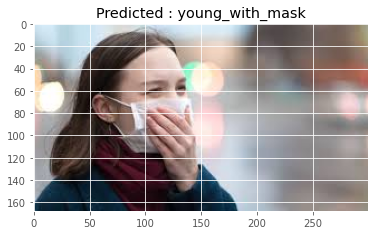

In [ ]:
predict_url('https://encrypted-tbn0.gstatic.com/images?q=tbn%3AANd9GcQKJX8iWbMj_pJl9lL2moU759NqbNMn9aR4PQ&usqp=CAU')

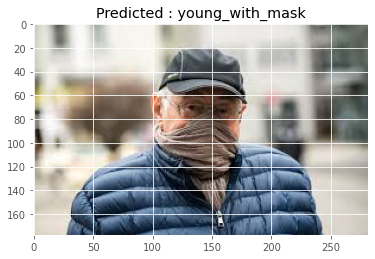

In [ ]:
predict_url('https://encrypted-tbn0.gstatic.com/images?q=tbn%3AANd9GcQFAFsKpQcrrzGQvjzhMSdB3oR2JyGx6KLFTw&usqp=CAU')

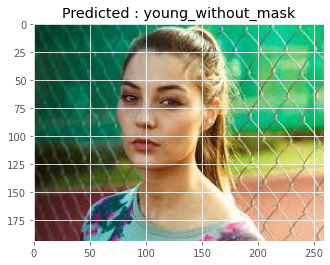

In [ ]:
predict_url('data:image/jpeg;base64,/9j/4AAQSkZJRgABAQAAAQABAAD/2wCEAAkGBxMTERUTExMWFRUXGBoXGBcXFxUXGBcaGBcXGBUYGhcYHSggGB4lGxcYITEhJSkrLi4uFx8zODMtNygtLisBCgoKDg0OGxAQGy0lICYtLy0yLS0tLS0tLS0vLS0tLS0tLS0tLS0tLS0tLS0tLS0tLS0tLS0tLS0tLS0tLS0tLf/AABEIAMIBAwMBIgACEQEDEQH/xAAcAAABBQEBAQAAAAAAAAAAAAAEAAIDBQYBBwj/xABCEAABAwIEAwUGBAQGAAYDAAABAAIRAyEEEjFBBVFhEyIycYEGQpGhscEUYtHwI1Jy4RUzQ4KS8QcWNFOiwiSDsv/EABoBAAIDAQEAAAAAAAAAAAAAAAIDAAEEBQb/xAA1EQACAQIEAwQKAgIDAQAAAAAAAQIDEQQSITFBUWETInGRBRQygaGxwdHh8FLxM0I1Q9Ij/9oADAMBAAIRAxEAPwDzQGR1CfTEtI3UWHPeCdo6yo5Elw951qJjMOoUeS0rkwQrFy12H0eaIr3AcPXzUb6d+mydhm96DoVYqTXtElKynrOkSNdCoezhPoHvR0hWJlzONEIoEFnUfMKHsSDCnoMh7fmrQubT1IqYgIil3hk3Ph81HWpkHRWGEwRpltSoQ0RmA3hRuwUKbqvQHoM2AVngaQvmcGsNsxtB2KosbxcAkMHx/RVdTiLnGSSfP92S3U5G6h6Kk5Zqr9x6JgeF4Qt72IcT+VgA/wDkZPwVrgeA4NxlmIeHDchkeului8rpcQOhJjf7BW/C+LuB8UDTXQE6+cbpUpyOnH0dh98vzPQ3+wgIc+hiGOvMEEDrcSjcL7HUmMDq1R5NrMYddxcSqLgPtcaTQ0BpA0mRI3c6dAJ3+61HC/aVtVru1IGY5WkxOUm56AmYvsg7V7XAl6Mw+fO43A8dwnC1S1rK9Nr2NytY5xbPnM3mVTY7hDqJIqNg7XseszB9Fde0vssKzA+mMhBIZqLSA3yP6oL2e424j8FjmkScrKjocWO0EnQt68tUvPOD1egGJ9F0MRFygrS5FC0kG3kY5GxTMVTDXua0yASAeg0Vjxngj6VVzXAw31B5EHcfohcvaANPjFmnn+Un6H0W6OqzI8pUg4LsJe0nf8fvgDNKJwbQ4ua4w0NL/wDc0HL+nqEO5sAzaFyg5zSHTBFx0UkmJoNQlnltqvNErU9qIewPaXsEEeNg0H5m/l5jbyQrjsNTp+qsRKk81vj05h/D4LntIBLmZWyYh0gi/Mxb4bqJzYsVExkW/ZVi49q0n/UaJP52jf8AqG/MX2KKMcu4VSSqpRjvFWXVb+f06715U+BIlzSAczC1ot4jprpcCPKENUdsNTp+vkmhsdfulzjcuhJUe/LimrdHo39vtv0tgwbFJwR1I9sIP+aB3T/7gHunm4bHfTWEG8oAHSeZZdU9vzytx89iHIUlw0QddfMj7pKtRtqC3lL3RX/pHmjqUGyIc2Wg76J8DKOe67RcJujPVNNq74Cw9rHRKrSv0XQ9SmoCwW01KtMVKDWo+jdpB2uFDSF5Sa9TVnCbC2yu4pxt7wusQWZhroUKxifg6ozDN4d/suuMFFe4jK4qwW1wLJ95vzCVGw6lR4KqA8E3HL0Ts6u4qUGl4h2GqNIl/uXj+bkP3yQOPxRrOMTrPmosVXgNa27nHTktd7M8ADW9pUuTsUicrs7no3C5aefmYmrwh5vF0JW4Y9o03hew/wCHtI0CDxfAGuCVnR1VTfM8i7EovCA5XA8x8l6PQ9k6YF9UNiPZQC7UEqiGxiYelWMXOhNuZd4fm1XPs/xzs3tc6IbB5RYSZ1mLCOit6Ps0xxhwItB+x/fJM4n7L02nuyRq4kjXoNkvMmFbgbfA+29J7RYmLMbu90Q2BMADmbCZ1UfFeyqU6YPec92VoZzpsLi6eWYa+nNYPC4J1J0kSzeBYjW9vDvurngmPz1jWIGVrHNpTI8VvS8DoBJQ5+D2AdOzujaZ/wATg21Qcz6Xcda5GUEH4EfHosPiBBW79lWhzXAZstQP8ctLhPcyg3IAkz1HMLJ+0GBNJ5B0uR9Y9L/8lrw87LKeX9O4W8lVX6+ANVPajPHggVDzcZyH4C/VCvddE4BpyvaSWh5BJ2kaZun0QdVha4gi4WnNocGvFNprlr48QrC1S1wc3UfA8weYKPbgg7+KBDaklg5AGCPjfyLVVUyrjC1i5op6R4L2vFjPOBfyHkipNrYfhIKVOUZ8dvr9PEb+D6rtNjqbg8EDLedraz0hOpPdMREWTqtQg5YkkabAcz+m6COIm9wlg6d043X0OO4ZfPGXtBnDf5WkmG+kEecqN3Duqs8O7M2PeaIH5gPuOW4+aL+iRLETWxtqYKhOWbgyjr4YsvP2XcSTUHbQB3sjo3dE5/W/q13NG8T0vb97IKm4EZXCGkzbUHn+brPpCfTcpRuzDOEKTnG9k1ZX5/TTS/W3O0tGg0tBSU1LBVABDS4bFoJB8jCSS3K4caCsrw+B5LRKabFObZOr81qPQuyfidqDQ81yk6D0TqIkHcqMBX1EvbIyR4gqehcZT6JhEtEDRMYUS0ETvLTkOARTDLYOo0/RNxYEyBAKZReA4E6Si2FPvjmovxNnca+XNQVx3jyNwu0Hwb8iq2QKj2kkF+y+C7WuajvC2w/fz+C9LojugLL+y+DyUha5v8f7QtTRJhZbnrYRUYpInpmymAUVJSapbCE5qcG81E8prXpMxsUR8QogNLiY3QOBYXDO/wAI8I38zylG1mdoQ06SJ6p2PADg0WA29NUu9gnEC4hRY/x2aRHxtH0VBw+hlf3u65vdAiZnQsGlwRrI+MLX030iDTcGm0GT5X8lS8NqOfWdS7Mk03d3Q5PJ3K83+6mYBLQ03snRea1VzpOUAAukuLnCTJ200FrlR+1dBr3jWARMbOLZG/KCrHgxqMq9k+m6wBFVslp5yY1vEFSe0VNogEQCAOnx5i1+q0U3aNzm4+Gam0U1PCDsoy2hZSqzNLPeZOXq0at9NR6ha2jigGlpcLSD6WKxXE6g7QkGBm19Vppyep5jEwjmhFcdH+9COgZv8PLn6q1psshMS1razw0Q3McoI21HpCsaLLJNaVkIowzVJdNPIKbWGQuN3NgdXjRvqDA8iORU+GogC93G7j15DoNAgcLUDazJggB1iYF2loJ5akeq62q5riDIIsQfmggsyudGrNU4Rut9y4awCNvJENa0yTEi52t/MPvy9QqM1Xc0wYgl7WknKXAO18J1BjY6eqVHXQfTrRclG24/iUOaXnfwDk3n5nXyjqq6i4J/Fa5Ji9iRcRp02QLHLbRnlged9IS7SvdFpTFtT6SkoKRsElnc3c2wnJRSTfmzzA373okHaj4LlF/dhNBgg8ls6ndaVnHkdovymfin1m3kaFMqC881PgzMt5okuBnqS/7F+/0KhIKdUpQbabIgtATwJpiBpKOxk7WzuR4dwIyO9DyKHATyFPjIJDmiBA+O6oNKyuuI7DjMC06i7f0UIbP9tV2iYIPVH0yBWLgIHeI/4n7qpPQOhHvxXNoKw/tQ+k7+JScGaCxHz3Wy4PxijWEscDO248wsVR4sHgtcMw00lRYTC021A+mSwz1gjqCsk5HrY0+p6g1wUprAeSrMG8lgOqrOP4p4aQwwdkpzLVO7L9+KZElwHqhjxOhMGo0HzC82/wAKrVT36rviVZ4T2WpDxVnk+Yj6Kd1hZWj0PDszXbfyKH4kL5viqrgtCpQI7KqHN5Fayvhw9odEE6jqs9Rci4vXUxVOuDUzakaj623t8VpKVQuAdSqhpgS3KCCB5xcafBZv2m4caZ7UesbhSey76ufmJsTt/v5eaUgppG5wWLrV3taGxSbBdUNpjYCBBM9bIribxVpNOjTIvsZht+R08j0VbX43ALG973JGknXTYc+qWId2OFY14JAAn1lp+Eg+oWjtGtEYa8FkbZQ8XoZbjUglp55RJYeoFxzA8ljw7Mcx9P1WyoUn1WOpOgx3muNvCC6m4H3T7plZHEN70jwnS0R06ELXRlfQ8j6QhktNcfhz/vl4llw54eBTdqP8t3/0J5HbkehRhqlogCXEwB169BcnyVLQNwr6kHVJrkafw/MjV/m6I/2E7oMQtAfR7z3b4fHl+8vAhbTy9Sbk8yjB32/naL/mYPu36eRQz2FOpSCCLEGQUuixlaV5d7iONQASbBCuJcZNuQ+56/RGVKPaOzAQwG427TUtHQAgj+qPdK47DGUvZjakZQhZbv5fkjqM7YBn+qPCf5x/IfzcjvpyVU0XVljaBAnQhEDD9sQY75E1foHdC64P9LjuFpjPuXOe8M8RVts1u+a+/wAyupvMWaT1kJK/HDklnzs6Kw9lZRXx+54oyy7WBseaa8RfmpKQzCN9l00uBqqy0U0cpukQddk7Dm6jpGHTyUz6ZBnY3VoTPRW5hzu9HzU7Gx5IbAvueRsiXmExcznzunlA8W2HGNF3DPHhOh+SmqszUxGxM81A2igbtqa0nJKIiIMK04bgjWpvbMQIBiTfb5KDEUJhwFoA9VovZamAwzu77BBL2TXgoueJS5GOp8IDBUa+kXv9xxuBB0IBBb5jmpeFYGr2kTDf5QSct9sxkBbutwtjjpK5R4S1twAszk3oekUYrUteCM/gAO1Wc40XufAErW0qeVkRoICpauDJ01/VKnEODtdmZw+IrVS5tEDui5JDWiOsEuPRojqqX/zFVmD3p/lOaPQgfVa+twl569JII8igB7PEn/LjrI+oVqUUrWLyybvck9nOMCp70H97G/ovR+BYvtGgeiyHC/ZSkDJpgHmJ+a23A8D2ZtokSV3oE3pqQ+1eAzUDAvErCYTF9k0ta0F79793rGx0tdercVjIBzt8Vi8dgBTqk9nmaRMTBAm5+M/NKnaMi6UXUDuF9gWCmwHtgAc5JgkEOIMnUibq+4pTzUSJjT0IMhZwObSLajRYgNAi8uOT9T6K/wCJvmjMRPO0nKShhJuWoGOhCMdNramSw7XycxlpkBpEd0iDI2JUdfhfj1yl2YdDuPgT8ka+tMOiZF4O8kfPVRsxbQe9YGzt45H0P3WyGbgeTrKnNWn7gE4NrBMeQ3J2COwtOBldABMmNGnn1HP480F+Il5JNmy1vKdHO+w9eamGLCPLKWrM6nSo91e/7BjqIFjqonENuf35LlKvmGXcDu9QPd/T4clXsxOZ87Dw/r+iuNJgVKkFaT2/dPH+y6whyth3dBcXc8pOuY8uuxJ2uJyBN1Xiun060jLuPD1A1b6C46SOSF0mx3rMZ+JFxipAsncGrZcx2cACdYgzMRJH6W61vEq8mAVzhuIiyNQ7pjWKVKvme7Xkvu/l46aZ1aF1VbMY4CA9wHIGySDs0bvWofy+H5PH6NKQRyEpMaRdPp2KlqRaN1tHyazWZyphzY87qSnTJGTnou03yI3CaK8ERsis0JcoyVuQ+nRIsiX08wHzUFR512KlwmIMOaPe+yuz2FZqftBOH7p6bhKrTGe2myDNUoh1cuptAHhmT5qsrZbrRWqDsI4HuHQ/I7Kx4K+C5vIrNZzzVxg8QBVYW6FoB/q3KGpF5TRgMRGFdN8dPM2tFtpT6MZrxYW81Fh32VfxPCVCQ6m6CNQdD/dY78j0+VN6mophuW5GnNVGMfkcARErH4h+Ma/uwcvqD81a08XiK4ZnpluW5JOp0tCXKVxqpW1uaRtHMJT2Uo1UOCqWun1qyFtWKUdbBlKsBuj8Liwsu7E3VrwYFzrpEqg7slYt8diO6XHRolVLHOxGaIljIcTzkkxzNwpvavEdnTawe8RJ5AEXPrA9VkeN+07MOx2V2eo4EZBdsCbvI0HhOUXkeqGKbkSLywzIj9oeNFuKo4ek4jsgDUiLvcQQ0jYhpn/etZWxjnNpAmzqYcL2zXEGea8h9m6rq2JdUqOLnvcXuJ1LjJJ+IK9Iq1P4GHdJDuzi2nekGOhKKyhVt0MOOk3QzdQDiktI/MJjltA6T85VfUqmDfb/AKU2JxBqU8x8bDDwdbwA6NtIPXzVc2sDc6bD7rrxlGMbHgKsZOq6n+uj/Hne/LUuMU4FtNzRDcjWerRoeRiPghg5RYXiAYSHCWOs5vTYj8w1H903Gjs3QTIgOa4aOadHD96yFaqJaCK0JVpOolu9Vyf54ftyXVbawP739UTjoFQkABpJc2NC0m0dPpoqM17yfTp/dG4THtI7Ooe4TZ2vZuPvDodxvrqAg7VXuMdJuHYcb3v12t4defTUM/FlMbiiCDMRefJVuKrmm8scIc0wfseoIg+qjfjo8/ogdVA0sNWc02nZasuOItyuAmSWtcdLFzQXC2lz8IQrXLmDx7awFJ8B4tTebDpTeeR2Ox6aVlXHFri0tIIJBBsQRYgoHUVtw6+FqzqOcU7N3/BdiskqUYxx2KSHtI8xfqOI/i/IydZ10+m4ZTz2UFKpIjcaJja2UrX2iPT+qSafMKZWgyFLUbB87oOq+HW0NwjQ4PZI8TdRzCvtEBLByVncloS4ZB5pNBCgwmKhwPJWZyCORuFaqpip4KaehBiBmgj1806g+D03RmHe0sc0AXM/BCiqAVfaJagLAzaynKtM5o2RfD/EAeae2oDTB5WJUIxQCp1EMhgZXTvsbTB4uGiU6txKm13feG+f16KlzlzRlMSJn0VPW4VL3Z6ry46G30WGPI9dCmps2lLEUpvUZJ07wuicwGq8+HA4/wBUj0R2ErYpndYRVZycYI9UMo2Gzo6XNm6sAhqtZAYOq4xmEHcTZGdks0mSOg2lcrV8BZoqChRhaLgxyguOg/YSeIU3dGY/8UuIjMygD3jDj5CcvxOb/ivNuKUpa5+k/J1muB+R9QrX2ox3b8TrXsHdkOmSx+LpUmK4fmp1G6SATzECM0dBE/09VoTy26me10AeyIIc4+EjnceF9/jC9JruAoYd2X+GWERrBPib5ti3mV5vwBpZSqh40A/+UgQeX6rd8G4i3/C6JeJacxJ5FroIHWJ/4xus+Iu5NrwBqxvSsVTaP/5LGk92o7I4j3maOBjeLKuzNDiORI0g2PLZT45zQ5wLjAOu1xLHAjS1wYuEyow1Wl0h1RomR/qMGp/raNeYurTbjl4nOnh6a4DoCsMIztWFhiKQNQHfUSyeXveY6qkZU0U2GxxpkwA5ps4H3hynUdCFUb8WRUYrVIMxNAHRNq0e6uvp+F7SXU3aE6tO7HdRz3FxyFxhsFmF0qU3HRhRpx5GbxDjUpEwTUoj/lS2n+hx+DvyqhZiCSvScFwsd8x3XNLJEEwdSAfh1v0TB7IMF4B3n7hO7ZWHKC2MCQ6FYV2nEUxUJirThtQn/UZo2p1cPCefdPNbH/y8Bsn0OFNZUFgbHMI2Iy3toZI/6VQxCcstimoowLqr/dlo2HILi3A9mRySQetF5keL4SvldJTK7zJUeJbeed1KzvM6t+i7lhFuJNVP8Np3ldwFch462PqoMPUvB0OqT2ljo+Coq19AjEHK4gGYKOwlYvpluuS/pugKnebmGo8X6qTAV8st0zCCUNrMpq6DKWNIII2ReOIJDm+FwmOR3CqMhBgqyY+aOQag5uqifAFq1mSYPGZXQ7wmxTMWxzHFvL6bIJtytFh8M1zGH3ogn6Iakssb8glGzuT+zeKDm5D4m/Q6fotBU4F2okGCqBuC7Mh7dR81q+GcWblE9Cs0KkZ6m+lKVrIp3eytT+aR5lT4bhrqeq0H+LshA4nHsduFJWNOab3BajDspaNU7oPE8RaBYhAu4oBv90hjIo0tOtP70V1wvEZ3BrfC2/8AUR9lg8PiX1NbN5fqd1vvZGhultNskmkjwqniSa76h17QuP8AyBP3W+x1UdlTrt1BGYbFpkaeQv1WM9puGOw2NxNI+69zm9WvlzfkY9Cj/wAcRRtpDDG0EgEHpcD1K11Y3s0ZqbL+nhQ6jiWtuAWmmCQS3xAtE8nAiOk7qw4Hgu04XVokgOY5r2//ALGte0DzzEearvZsdphcS2JIIjnaYnrGUT0Wj9lXfwy4AFtSkC5pvem9zXjoNCPJYpSyt35/QKr7HuKDD8HL6Qzas7hO4E90kfy6tPIgHcqHhnCqlKoCPdPmDB+fmts2mGuD2gQbX32c13X66qV+FbGZpEcj4gTt+bpCzutNOyOZ2jZk8RwOajixpDD8iQC5o6CR8Qp8PwHotNgmHJkcIOZzg2LkGNT/ADQLhEU6SqrOV9COT2KTB8LySIlp8Q8tCOo1Hw3RtPBycoMtbqRo60gDpBBPmOqsntDWkkgAbrvD6UUWSIIBzDeS4mTbeZ/6UjdxbfAiucZRhSsEW2J+B/Q6HrB5qdhCccu8KoPKwtQXE90AAS42aOu5PQbp+Hwob1OpPMruBIcO1dcuENnZg0Pm6zieZjZEGoEc45XlLGjDcnOA5AwEk/tuhSRdpPmyZT5ZeM7ZHu7J2DdqP5rLmDacwHOylfhyHEcl6BsHoQupEGCjMXSswjWLoh1LMAdxYozAUQQWHQ6dCgcuADlZXKrh9I5o2IgpDDGSOqOZSh3kjX0RAcBY69CglPTQjlZgwpZmg7ix8tlLTpkEEIjBHxAe8ITiwjUaJU5S0YLb2IquDGYFuhv5cwj8K6LbFLCNJpkAbz1hPFM8kutJ5iJStYe+o6cu+6KpUwRl3GnVRUaJcA7c6+iMwuAe5wDddegA1JOwSWnGWVF99K6I62EjRzh6z9VWYim/+Yq9JGhvtIUNTDg7prO1CTa1KOnh3HUko6hgrqyo4MI5lBLbDuQ4LDaL0H2ZZDVkKDLrZ+z5GUoY+0hdR91lD/4mex/4pgxFEfx6Ygt/91muXzFyPMheRuBbSuDABZBFxoYI5iYI5hfRn4gB8FZf219iW12urYZo7bxOZo2rGvk4j42WjWWwiMsujMh/4dtzduzQuptqDebNJj1aVrOF4cMcBo2XX2h4MwNrkmOixnsA/scXTDpHedRLXCHN94NcOYkj/avUuJYaKLyAJbedPDv6hYqlLNN2GTeiTKVrXMc5hFjYnQAjwu8ufQlA4ZtR7hUNgJyDbkXnz26eaI49WBY0g92qwEQbzo9v1+KjxeOmHbECI0sADrv0V+rrL+7GaOG1D2scR4iCL2NrbjkpyyRmkD+bkDz8jr8RsqNvEOq6zGZ3NpEwx9nm3hF9+oHpmRRw6tlYcsLlVyzwtMVSKjj3Rdjef5yOfIbDqbHS1u88xz6KgHEE38c5EqSWqG+qo0UsEG8ESP3529FBXxQnJTAzaknRg5nmeQ+ypxjXFpbBLiZYOsd4HplE/wCzqoqFRzREyTcncnclF2UVqkVHDrZmpwQY0Bg02JjXr5/Ly0T8S0HQLNHEO5qfEVi5meYLbP8ALZ/2PpzR5U/ELsFF67F9+Maksg2pVNwQ0HYgk+t11VlRfY9Dx84UB1kUcO2M3xQL6tgfipMNVJkTqF0svAydktywwoEEc10uA9CqptYhS4gknNsUORPUJUYlzVezNIEAqShUDgadr38oVThzmaW7i4UdCqWmVMivcLsY2sXDazRyUmJrh7QRqPF5c1U1KehGh0VzguGup0nvrE02OAGWJe7lA93zKKnRcnZIOVOCVyKjjA0o51Cq9wFFrnB0Q4Cwnm7QKofxGm3/ACqQ/qf33eceEfBEcMfWxVQUu0jeCbAbw1Ojg1tJnOrekKadqUbvrojV8I4G538N1RgOsMPaObzLi3uj4yjuM0adBoo0yTnMPcTd0AuI6Cwt1KP4YKWHpGm1wljczz93fP4LK8erT+Ge0Hv1jzPja+CfkrqUYwg2t+ZioYqrXqpS9m/DboSBtvVcEIqnSs4eXzCBqUnTYrjyPRw2LDDGVMSBuhcLTMXU7AlhBFI33Wn4PXyj6qhwdGIVtRMFWkLky6qum6NwOL2VI2r6zaynpOIKKLad0C0mrD/an2YbXHb0ABiG5XDYPLDIBOxiRPW+0XGH/iUZggubcGxDouDyK7gcSjwNwtUacZvOveZZSlFZX7jzC9Sl2bmgOY4ubGwOojyE25IfDmJa6cp16HZ3p9FpvabC9nWzsEB1yNg6dRyn6zzVNUoA3A9OXl0SGsrsdKDUoXK+tSykg2jVdoh2skco2RTqJqf00yGuPMkSweg/+qlbRU2DTzLUY6nmGYCCPEBp/UBy5jb1s1tNF0mlpBGo+B5g9E3EUgXZW+HUncA+5PPn/cKNXKTyuxDhiM4dfugiRHvCDHOPRTOox1GoI0I5qZtECwU1Nvu7E26H9Dp8DzU30BfdebzBBSXRS77AfAT3hzGw+MHzARFSG6+Ubk8l2nR3Nz8gOQ/d1FpqSfeViLslxF5jyaepBn1hwSUyrmVnl/F/D7nz7QvYrlJ0GVxggqas2/RdC+hmSHYinEEaFSsGanA926VNuZhH8t13B1Mrgdt/JXoGkMw5hwU1WnDjaEq9GHnlqPJWfDMKKxa0mCDfq3dUlfuluShFzlsH8Pofh8P278peb02u2/N5nZZ3HcSqVTL3EhWfH+JCoQwgDL6RFgB6Kor07CBoupGGSFonHqUas89aT20tf4L78RBkzaBrHSbXVjwvh1Qg1CTTptBcX6Exs3mToivZ7A5mms45WttJiBebT5pcc42KrRSpthgMyfE4j6DoqcUle5z8RTjGKamm3w5Lr9gjDccP4d2HYwBz3agySDrmJ1PVXWKoThaRiTTFN/8Axs75FyxeBxApvDiJjUc/Veh0ngtGXwkZmzrBuQfImEuqk4WGU8tKEbe1e/Sw4tgGN4+6i/D2lNpHJLSe6SMp5D+U/ZWL3BwAF1xKlNptM79OonFOINSoGIU9HCEao2nSgJ4BSsoeZjKbIhFUjGqYwKemyVYJJTeiqTpTGU06IVWJcMo1Lq6wdeRCz1J+yPwbiDeyZSbUtBdSzWoZxvh/atkDvN06g6hY3FfwiZBmYDYuZ92F6DTMhB4zhjagAIlwBDX2zNnbqNPgtNSjm7y3Bo4jJ3XsYnDUonMYDzMTZhAiDzHX15p5pwYOoRWKwhY4tdqPn1CaRLb6t+bdvhp5RyWS3A3pparZkD3ACSYA1TsE09mJ2LnX1hxFz+m0qDDs7Qh58I8A5/nP26X3se0Rca/v5KIktdRganBilc3caH5cx6fooatWDlaJcbxsBzcdh9VViZrq5ymM8VTpcN6xEv8AN1j5eZUuVPweHhuSZI05H8oG3T4JwCuXMGD0sR5UlLlSVBXPnaq2881M27OoTIlvknYbxLo8RC2HYZ2x0KdUZBgphbBhTvBc0O9FXANE1ZxcA7kIVr7OUZL37hpA8zuqjDPgwdDYo7gld+epSGmQn1JEGfJNoq80zNjU+wlFO3jyDf8AA6Rl7nlxmSSYBjoFX8U4U5re1b/lkR+x5rQDhDngAvmBECw8yVa1OECpTZSLnBjInLHejYztN10Gll0OHiK1ONDLGpmbld8ra+ZihXc+lTw7GEnlG7rkx9zshKeGIeWyLSJ2mCPrutxxx9PCUXdk0CrU7oOriTqSTewWT4Vw1zntBaXBwzW/KQXNk9LeZQpcTJQpzcJVbaL5mqwvstTim6oSS2CW2yusIB9Vc16c9DspqTiWgkZTAkawdxO645Lm7sKdadWbnN6sALdQR5hPonLYaddvX9VM+nP709VH2DtoPnY/p9FmnTUtzXRryhsyxp4oFTBwVQKZHuuHz+inpvI3Wd4Zczcsa+RbsAU7HCLmFSit+ZdaZ2cfQ/XRD6tzZbxfQum4xo/sm/jOQ+KBp0Xnk35n5KCjxClnLJNjAcbyd9NPNMjho8rlwlWrXyLbkW34n+YwPh/2nYjieRvcEnYn7Kq4pXApl2YC1ja+6yrPaaqLB2/90+NNILDxanmqK6N5g+PPeYdVgj3RAWi4fWHjLr8uc/JeS/ioLaj3AF8mxzEwLmBpe2t/mr7Be0IbGg6EmVclbY11akJXUVZdD0HjOE7SnmA7wv5jcff0WRxgEsafC54a7mWkGR66HoSrvhHtOx8BxHL9ymcW4XDzVHea7Tk2dQBsCd/7LFWh/sgKE9Mj9wBCeEymNuWnUDbzH08rvCyNG1O5ypVgQBLnWYOb4t6QDPkOS5hqOUay43c7mfsOQ5KFr8z2vbMMJvzmxDfhr0jmjPpsi4AL2mdUtQyM3/Lz5+v1BUKgxDpLaZMNeYceYF8vqY9A5RciT01GDFVHXZTDmnQl+WRziNOXRcRgSVXLsz58wmp8lHRSSW/gLQXjPF6JM8PquJK3xC5DhqPNWfA//V1f6B9QkkmUNzD6U/wM2+B8JR2G8K4ktx417sxPtK4nHEEyA0QDtzjkr32f8ISST1/jPYU/+Ifj9i9TTokksbPNw3EEgkkgZoW4nFcznmUkkDHRCKTipgkkqCKz2hquaGwSNdCQh+DCRe9z9l1JPj7B6vCpLAJrr82Be3ogUotMzG9gs1ihFNkWkXi0+fNJJVwOXB//ADn4Ifwpok29x32RtFxL7me9uupIHsSP+JGp4XcNnl+q3GC/9PVGwB+iSSyS3ZT3RTDUebfqFBxYwypFv+11JYeB0Hu/AJAiwTqWjvMf/wA3SSURJcBwQGMce1AnSm93qHMg+YnVJJXHcGexZVfEfMpJJKmRbH//2Q==')

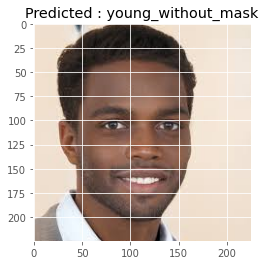

In [ ]:
predict_url('data:image/jpeg;base64,/9j/4AAQSkZJRgABAQAAAQABAAD/2wCEAAkGBxISEhUSEBIVFRUVFRUVFRYVFRcVFRYXFRUWFxUVFRUYHSggGBolHRUVITEhJSkrLi4uFx8zODMtNygtLisBCgoKDg0OFxAQGCsdHR0tLS0tLS0tLS0tLS0tLS0tLS0tLS0tKy0tLS0tLS0tLS0tLS0tLS0tLS0tLS0tLS0tN//AABEIAOEA4QMBIgACEQEDEQH/xAAcAAACAgMBAQAAAAAAAAAAAAAAAQMEAgUHBgj/xAA/EAACAQIDBQUGAwYFBQEAAAAAAQIDEQQhMQUSQVGBBgdhcZETIjKhsfAUwdEzQlJysvE0Q2KC4SMkc5KiFf/EABkBAAMBAQEAAAAAAAAAAAAAAAABAgMEBf/EACMRAQEAAgEFAAIDAQAAAAAAAAABAhExAxIhQVETMiJhgQT/2gAMAwEAAhEDEQA/AOsBcBHM3O4XENADZ4rvC2Q6tNTje65ff3dHtkR4ulFwakk14muF1ds85uaaHshhNzDwvrJbz+i+hs8ZtKjRV6tSMP5mlfyXE5/2p7eewi6GEa31k6lk1HwitLnNcXtWpUk51JynN6yk7v56Cy/lwrGa5dwxHb7BR0qOWdsov1Of7c7xcRUb9k1Tjyirv1lx6HgfxDazZBKq3khTD6ff8bnGbdr1PiqSefMqS2lPjJvr9ChZ6cRPLQqYxPdV7/8ARnwk/VlvBbdrQzjUmvKTNBFscstR9sLvroGxu8TFUluuSml/Gr3zzzVmdA2D3hYWu1Cq/ZTeWd9x+UrZdTgXtrZ5EkcVYm9OK7/r6opVoyV4tSXNNNeqJEfN+we1NfCyUqVRpXTcbtxa4px0zOobC7zqFRJYlezk3a8U5Q8HzRncbFSyugXHcjo1YzipRalFpNNO6aejRIAFxiGAAxDGQAAAALgJjI7gIA2GIhgQsgGa/bm044ajKrLgslpdvRZgE+M2hToq9Sajyvq/JcTn/eL2zTpKjhqnxX33HW38KfDx8jx3aDtA6laUt7feT3s7J8o3+FK/LgecxVRyd+vUrGW8i6ivUnfMrVJ5NksqbMJUlx8TWMqhpRbt9+ZNKSjZLiZwX/JhH4nLqMmNWe7ktXqRxu/zG05O3qTKP7q69QDCUVFFZQu956Fxxb16B7JvwAaV7ZW53fQjhq7lr2DbvkJUks2+NxlpBpmWMNWutSKcV+ZlRjusA6Z3ddsZUZxw9ef/AEZe7G+W5K+t+Tvn0Oxwkmrp3TzTWjPlylPlmde7rO00qt8LVkm4x3qbeTsrJxfPX6mWUayujjBAQZoYkMZABgMEAxWGRWAYCCMAAhYOTd6O23Oq6Cj/ANOk7Xu7e0au3yuuCOso4P3hyaxVSKb+Ocms005P+/Sw5N0cPNylyIK9Wy0MJuy1zIKlR8DaRnaPat28xzk2sjFRbeiLmGwbkF8FJar0iSMG75fobWGyS9S2bFE3ONZ060NHC8lmTwwcuEep6KnhUtCVUiL1Gk6MecWBlwjdGMsPNaI9NuClST1RP5Kr8MeUnQkRSoPkernh1yIZ0UV+RN6H9vMSwpisLbXM9DVwkXwNfWwDWhcz2yy6dipCNuORvOxu0Pw+Mp1b+6naX8sspfLPoaKrGUdU7EtBtPLMqofTlKakk07pq6azJDnfdZtmUo+wd7KLle987pJLll9Dohks0MQwIDABgCGAyIRkIQRCYwIWSOB95lZzx9a6as4xWXBRWZ31Hz12+b/HVr6739isOSvDz0orUhc0tDN6MjhBtmzJPh47x6PZ9CyuarAU1yPQ4eORlnXR04ljEzURmSJaHGmS+yCmTwROlbV/ZA4FhwFuC0e1ScCvOmX50yKVMBtRdMxnTLm6R1ComtbXwykrM0c6ThJr0PUtGn2rQs0+ZeNZZ4t13ebW/D4qF1dTe4/91kmup3hM+b9i4hQqR3ldb0b52eTWj52uj6Lwre5G6s91XXLLQMuUekoxDQgYxDGRAADIXAVwEaIAAhRHA+8qL/H1m1b4fS2TO+HHe+LBRjiITSd6lN3fB7rSXWzKx5K8Oebq5P14mSppeIrfqS5GqF7Z/wDyegw8cjRbNpNs9DBWRlly6MOAETFsygSvSxTJ4MgpksUFoiSWn3YaQbpkoCNjbIhnAtKBjUgLZ6UaiKlVmwqRKdWI5SsV7lTacbwvrb8y5Ygxa92XkVEVd7uNk08RjIqrmoxdRR/icWrJ+t+h3Q4r3T03LGprSMJt9Ul9TtSKvLEDQhoQMAAZAQxMZC4CARowACFEc+74dnuVCnVUb+znaT4KM7LPql6nQjUdrMF7bB1qfOnK3ms180h8B85pa3J4q6S+89DHEUt2VuWqepNhl7yj4o1qJPLd7OobsS+5EUFZEdatuox5dPESt8xRxEU83ka5SnLP+wnhKj0WRXbPablfUb2GKp8HcuUKkHozyNXBVFnx8zGlKcXq/HgFxn0TOz09z7o0jy9DHyy424vl5G4wuKujK+GuN22SiYyiRe2KeLxtlkTtetJK00Ua1RGqxeOd3ZlCVeo9LmuODHLqNtOurhUalF2d7xfrbI1Cw1SWq+pYw0akNc0XqM+6/Htu5WknOtOzuopeCu07Pxy+p1g573P4LcpV5W1quN/CKurep0IVQYCGgIwABggGABjYDIBBCAAIwee7S9o1hmqcIKc2ru7tFJ6X5vLQ9Ccy7yk44hNNq8IZrzkvyFldRp0sZllqvA9oW6mIlP2agpu+7H4VlnbkVcDD309cz0VfD3it55vj4mnoYfdqJP6FY5bgzw7a3ko5FaUE3mizJ5FaZDRjWxUYZJZ8EuPQgrbSlDOTjHw+KXotCKvhpPSVvE2FGklhp0J003KSmqqzmmuEr6x19SsZPacrl6jWPHSnZWq5tK+4rZuy18ch4mjOLtK+8vijKLhNPyZNsqnONS9WU3TlJSqJTu5KMt61m7Xu3rpdno+0e1aeKd/YpW0cpret5pZGlmPpnjc/bylGbN5s9NlPC0bfFZvw/PxNlhZ20RjnG+FqbEJpGgxuJ1PRYmrvRNBOn7+ifJPJN8LkYSbXnvSlGMmt5pKPOWS6Cp7Qgv8AMiv9krfU39CtD2NSnUpNzmnuzvFtO2m7yvyNG1Wb3JS91x3Gmo2Ucsm7XtkvQ6ZMfbltyl8J445vTdlz3df/AFeZPh6qnoT7enh50qdKhFucFFe1s4/CrXV/Eo7Pw8l8Vun1Iyxk4XjlleY7D2Dwyp4WKV/elKTv4tr6JHpTT9lWnhqTX8CXVZP5m4FGV5CGhDQwYAAEAEAwYCAAiGIZJkznvedQvUpNcYpek5fqdDPKdvsPeFKf8MnF9Vdf0snPhr0brOOfbQxMKas1vWX3Y17tJwmk0nmvQy2jBynuvi7FzEYdRULaJW+RODbqRhLQiUSSTzsEFmPIsWPs+QnRn9/3LtOmSOiLatNU6Elr9+plTw5svw5LTwt9EVMk9rWqmW6cUiWtTUHZ6mEWmZ5ZbaY4/GclkarF0szbuWRr8VYWN8nlPCqndZg4yXiTQp3HKi0bd22PbpTc5PgWaCMvZGcI5i2WnUuwdS+Fj/plOPzv+Z6I8z3fv/tmuVR/OMT0xUYZcgYhjSAAAAEwExg7gK4CDBDEAjMp7WwSr0Z0n+8snyks4v1LYAcuvLi+LwblNwneE4trNcufiV3Fwi4yd87p+HH78T33brZeccRFa+7Nrn+6356X8EeC2hGyum/Exn8ctOvu7sdo5PO/NGVF5mCzinqYQnZmuUZY1uKFi17NGrw1cvrEEaays2jJVEk3yRXdW4nIUOsKdHfzfzJo4aMXnL8yjiKc7WjLL0dvMpQwyT92dRPxnvL0Ydto75HqZ0qTStNeN0ajHYZNuzTKsqk9Fn4lLGYatJpqpurlF5+odv8Aguf+riouFuRZhZlOnv2Sk725u76k1OQ4VTSpkdjOUyJy5B7K8Okd30f+3m+DqO3SMT1BrezuBdHD06b+K15fzSza6adDZGkct5AAAyAAAEQMBDAGIYgwAQAZiABATgpJxkk01Zpq6a5NHPe3WwaNGMJ0YuO9KSkt5uOl1k726HQ0ea7fwvh4vlUXzjILPCsL5cvpydrPKz6c/vzKtXXqT1spZ3S+TIMRJcM+TKVwmo1OZdVXI1VGZeSe67ciLGky8Mo43XqP8aaqFSK+JtLVo2eD2lSS91J+ZfbEd1vtnCc5fCm/X6mSwNS+8o9G7dCaOOnJ2SflFZ+iEqsndJSy8Hl55CVJPaH2Ve/7P/6RFiKFe91D5otQqVHlFSduCi39CGviZx1i1nbNNZ8vMD1FaNWa+KLRKq6auiGptHnmuKCpKDj7uV3YNFbZwsqrdXLOw6ftMTRhznH0vd/K5raN1H6npO7fCe0xXtOFOLl1a3V9W+hPbossvDq6GIBsTGIBgAAAQEADAABiNGACEDAAAGjzvbz/AA8f/Iv6ZG12vjvw9J1XG6TS1trxb5Hhds9rI4uk6cYpOM1J534SX5lWXR4ftHjMda+ZTlV+f6myxEb3Rp5pxbv9+IsbuLz8VPFl/DyumvQ1kMtfUmpS5FaKVao4f3tDYQwlnvU/dk1nbRryKuFfM2SfIm5aaYyVudk7ZnTlvShGfu7uiTyd9T0GA7T0E5yqU3Bu1rLeukuLS+8jxtPFr95dS86sWuAdy/x4XmPX0O0mDhvON7yld2pyvovA0+0u1EG7UaG9aV96orR+G10lnf0NRCUEtPK+RRxmJSyj8g7rR+Lpzz5rR7XwTr1ZVJ5Xd7R92K00XQjjQUUorh+ZflIp4mfBBtGUnpDia1lZcbHV+73ZPsMMpSXv1bTfNRt7q9M+pzjshsh4zExi/wBnBqU3wsuHV5HbYq2SC/GVuzAQCSyAQDBgAAAAgAjAQCNgAxADMoRuabaW3IU7xj70lryX6l7Y8qkqanUec/eSSsoxei8+Jphjupyuoz2rg1XpTpS+GUXH9GvFanBdmYWeHr4ijWynGSh0V2pLwaaZ9ESgc77z+zzssbSXvQW7VS4w4S/2/R+Br1Md4+EdHLWXl4qRTxeG3s1r96lijUurkjRxy6rus3GjlNxyf2iWlU/uXcThoy115munCVO+V0bSysMsbGxpVOXAuUa3B+ppcPX8fvxLlOsna2n2sguJ45Ns2mU8ROccotmcKnPpbQsKUZLNeTIk00t219OrWldb335E9OjP95kyjGOnIgqYxMd36Ka9spTSKGIbb3YpuTdklm7vLIK+IWt+fyPc92/ZvetjKy/8UX4Zb/1t6jk1EZZben7FbBWDw6i/2k7SqPxtlHp+p6ABEpAxAIGMQDIwEAAxAAADEAAmanbG01BOMHeXFrh15nnsXtStP4pvyWS9EU98rtG2UoX1ep0ijBJK3I5m53+h0jZlbfpQlzin8jfpsOotxRHWoKUXGSummmnxTJYmbRozcG7S7GeBxLpZ+zl71J/6b5xvzjp5WKsXc7B237PLGYdxVlUh71OXKS4Pwej8zjFGTTcZpxlFuMk9VJOzT6nH1cNXcd/R6ndNVM0QTgWGRszlbWNXicI1nDUrwxDi2pZO5uGitXw6lwuaTP6yy6fxBHFvzLVLFPma2pgbfCxRpVNLorcqNZRtpYxZlCtitfBfoYrCTerRJT2YnnOTfhoG8YNZVtOxWxnjcSoyv7OHvzfBpNe75t2+Z3OjTUUoxSSSSSWiS4HPu7OdOEqkMk5KKS5W3nbqdDbC/UcXQEFwIMDEAjMZiMAYGIDIwATAGBiAjc8kzGUnbT8xzlqRzkrfqaQqwdTm+i/4R7rsZit+hu3zhJro819WuhzypL7seg7D43dr7jeVRW6xzXyuuptgxzdFRIiCEuBKjRkbRy7vQ7OOEvxtFZZKuly0VTpo/Cz4HUiLE0FOLjJJpppp5pp6pkZYzKaq8Mrjdx8906l0EzYdrez8tn12km8PUd6Utdxv/Kk/Dg+KNdvXRxZY3GvRwymU3GDkGQmgQjRzgEaSM5hSQ9lpJKCSuY05GVXkVMXXVOEpPgm/0HjNlldF2c2pJYqU4v8AzN1f7bI79hqu/CM/4km/O2Z809kISln/AK2+uR9IbAhJ4WP8W7dea0Oy47x04e7ztaC5BgMbCtDfg/CS4xfJk7ObKa5bTyAEBJmAhgDEAAAAAMgAAI3Op6dGC0XT8gAuFWtrffoy92W/xND+eP1ADbBnnw6jLUniAGjJJEbAAJ4nvS/wFbyj/XE5Nh9F5ABy9f07f+biszOH6gBzulFPRdPyM6QAUR1DT9of2Mun1EBphzGXU/Ws+w2i/mPo3YH7CH8q+gAdkcFeZ7F/HiPNf1SPSsAOfr/u36X6kwADFoAAAAAAAGNCAZMQAAD/2Q==')

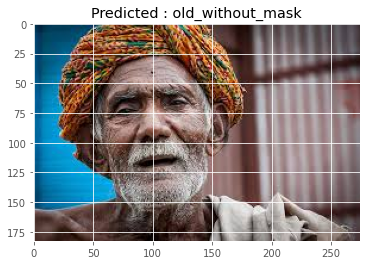

In [ ]:
predict_url('https://encrypted-tbn0.gstatic.com/images?q=tbn%3AANd9GcS_ilkYb2cfeeDJrh9fSD9pw0oTiWBTt-uSDA&usqp=CAU')

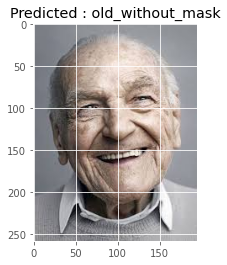

In [ ]:
predict_url('data:image/jpeg;base64,/9j/4AAQSkZJRgABAQAAAQABAAD/2wCEAAkGBxMSEhUTExMWFhUVFRcXFhcYGBYXFRYXFxYYFxcXFRUYHSggGB0lGxcWITEhJSkrLi4uFx8zODMtNygtLisBCgoKDg0OGhAQFy0dHR0tLS0tLS0tLS0tLS0tLS0tLS0tLS0tKy0tLS0tLS0tLS0tLS0tLS0tLS0tLS03LS0tLf/AABEIAQMAwwMBIgACEQEDEQH/xAAcAAABBQEBAQAAAAAAAAAAAAAFAQIDBAYABwj/xAA+EAABAwIDBQYEBAUEAgMBAAABAAIRAyEEMUEFElFhcQYigZGh8BOxwdEyQlLhFCNygvEkYqKyB0PC4vIV/8QAGAEAAwEBAAAAAAAAAAAAAAAAAAECAwT/xAAfEQEBAAIDAQEBAQEAAAAAAAAAAQIREiFBMWFRAxP/2gAMAwEAAhEDEQA/AIwE4JEqtJwUjQmNUjUAsJ7QkCcCgHBqeGpAU4JAganAJHPAzXMcDkgHhdCc1hPgpqOFcSg1eE4K0MGYueZ/ymOwrhf36oCDdC7dUrmQmkIJGWLtwJ8JIQDN1NKkITCEA0hInkJpCAakKckIQCJEsJEAPSpoTkwcCpWuUQT2phMEoTGlNxFcMbJ8OZSB1fEBgvmchxUNN73CZ8MlUpsk71QknQWt+yvUqZda4HlCm5SKmNqV3iZEz0y81cwlC596feE3DYfKyI4ahfKyzubSYEZRAifdkSoMtPL5ylZRETorNAclPJXGEFD1K59CRZWuX0Vc0nNPVHMcFSpssnL5qnXwMcfFaRlxmR811aiCOOquZIuLIOpwmFqPYjCBx9z4KhiMGW3zHJXLtFmg/dTSFOWppaqSgLU0hTwo3BIIiEkKQhNIQDYSJSuQAgFPBUQUgTCQKRqiCTE4gU2F50yHEnIICSrXazM30GpQ6rW3nScxkOA5qjTxDnEu/MdeCnpQPHL7kqMsl44iOEbvGb/c8EZw9Ezcjpl58kPwQAgC8nyMeiMYVhkWz8Fja3kStYS/dDhEXGqv0WbogWiwS4ag25jPxU/wwZi7fWdeik0mFbOU81YpUD62vfqlwtOBy9/srVOkZsgEps1gqdzWkZTOoTzQy19805mGFvYT7TajewxYJlXK8Aqw6mRlEaJrhof8pgLrh2QHv6qu4ax1H2HFEalGBneVC8iCeFz1CcFmwfE4be7zdc/eSHkeiPhwDoJs4SIiLqjj8PckXIzylaSsbApyY5Tuaoy1WhCQmkKUhNLUwihKnQuSAG1PCY1SBUChB9u4mXNYDlc9ffzRTE1txs+SzGLd3iZzKVEWMKZI9hEg0bxMmIEDw9lCcCJjmffyRGg6562+fmufKujEd2c3dvEa2y96IzgS50HIoLhHgehjifsj2z6ktyM9Pqs9tNdCWHMC6mDg07gy1/dVaQ1iVdw9DUmZ159dUyEcPTy98P3Vxhg9R+yrUaZjO3D5qXfsL+/fzVJWiU22R+agbVn6p2/w9Zv0GaexpI5qidOvgOKa9+hJ98hdUHsGom+cO+6mnF10WJm/om1KYnL37KqNxTGmC/dn8hkg+dx4K7SeCLEZcbiOacILq0zpoLJK3eaDqPeYViqyHe4OX3UWHaQ4iRByVSpygJVbdQuCOY3Akza49eYQRxWuPxlURCYQpCUwqkmQuSyuSAA0KQKNpUgVBQ2u+N3x+SzVd8mbrQ7ZuMr5dOazVWZKnI4uYU+G6QimHdLjGX16+SBYN+YPEeko7s4S0SPzZ8c/ssMo2xo7gSBfP38locPXteOXGOaD7Pw5IN4nQ2V4UY4EZTrPjdRY03sSb3jnEcJujOEIceiCYZ50I65/VFsJvNggtJ5mCgDHw5HNV8W06KWljASREZcI80rngnhx6KkxWAkTw006ptPGNg7xi973t8gpG1wLc/CNUJ2iWsNo3XZcQeBPvJTapebtelul193jfPp90ExG19/e7pLDkchu8YMCD9EL2ljnXa2CHa2mUOZ8USRPMkndibwdT1S3s9DuDa1slg3XOE7xk21NojO0cYRLAU3U3SC4iZG8I8AIiOcoHhtkOeJdUJJggHTOJMxlwV+hsgU3kkkkRqdItCcpaaJ9beMZXg8hEg59FSdU3XDPhpl5LmYrvRbODaCSOPvROxdMSDE5ceGar9TYvvcCPfzhZnaNIteeBMrSNO6AJkFCNs0RG8LaEfZbY1jQVyYSnFNJVINK5cuQAAJ4KYE9qoKG1292eqzNX8S0+1h3eA1WcxA8lNOKzbOHOf28lqMNUDGiYGlwLHXPXLyPRZkM7zeBM+GqPVMQwnvBznEGN1wDW8DaT5FZ1cE37QdAgB0z+oHxAG75KJm0nszkjUgujxNvtZUcPT3gd1pc4mN7ecGt1AGs87eKK0dgucAfils53kRzGnis7Y0kqSnt2cntaNT9INyrdHbm44OneblBEeUFVKvZQNADq0TkPwj5IVj9guYCWVA6NJn5KdbXuxrcJ2hAqkgwHGIvl4rS4Hage6D5cPFeIOe5rwCYdOa9Z7J0iKYgWi7nGSTxgftoizRyytFiS0H8QuJFwOqz+1MWIc3MWm8jkfNa3D0WOb3g11tRbwBWW7V4UNZ3BABm1hblopsEoNQotBL3CfoNRdT4fbDDMOY0TBLyACM8ib/sgmKoVKoDC7cabENJ+I6dDewVWn2SZVaWuexrp7gY0uDRzaAN43OqeM2rLptsJt/BNbunFUXcg4ROeU++CI4HaOFxILKNVry2C5oNxwJlZjBf+OsMWMbUDnFsEFtOjSJgCN57W77pz7xJJUON7Cvw7xVwdQ0nMBMOc5zXj9Jk5TorskZ423607MM5tTdIvE7wNzzE5XRDENsORHDy5oRsTbJrsb8Rm6/J0ktaCP0AS48wYiEfo3G7Nr3vnpoBx81M0eSY0PiUwAQDofeizeOqnecwtILIvoZ4BaPAVpF43gS06ZG9vEeap7ZpAza4FjynKfceK1njL+sy5MIT3phWzE1cuXIACE8JoTkwGbSdf0QfE0SRbxKKbbr7rmMGsuJ9FTdketp5/NRTkDDTESbxodfAZdVfw+LJAa1rImYEyTndxvxCGYkxMDjx+qtYGrLWEwJtvOiJEWOk2EKL8XBzAYg03OfG6zN4IBju55+Cc3b+Nrt/0lMUhkCGBz3XF+8I95odjWNcRDobZ1S8SWm26NItnyyWl2ViKQDbumDcAut4A6XyUfrbXgY3sjicRS36tWv/ABBdJ+LWZ8AtJ/KwAkGI8ZsnU+zNSm9w3Km638D2PLhUEXBYfwGxuFsaD2boiwNgd0k6HUX9FKKkZU6hB4hgvOW6XT6IuRTHTzfbGyCIIudRF5HiVouxG1nhr2PmWwBzBUu02031CMju3yDh4hD9mPDa7pyMDrwU29Kk7esbNlzZiLea7E0GuiY7vqCqWw62+0EE20KIkykL9ANrhtO3daDcSLdOqpYGo3eEVb/02HgB9RmtTVpBwhzQ4aghCsf2Ro1PwSw8BBHkQpu/Fbnqz8V8D+cGjIkbunKBHqmU8RSmzvivymQ6OcSI/tQZvY2Cd6pUPIGJ6rRbM2NSpNO7TAkXtc/1HVPdo6c/DVCQQxnDvFwtyO5bpz0TvhNaR+HfzgAdJBi6eau6bCBrkB4tt5qttGgKolgG8AYi2gMSMuqCNqNvwkg+P2yK7GP3g69wD4+7KltmnUdQcGzv7oIAzJaZjqYVDZmJmmZmcjPHonMuy47iOqoipnqIhdblMsuSwuQXQA1PCjaVIEAG7S4eQx4zaY88kOr1dJ6x0j7LQbVp71F/ISPBZB5cKm8MjbzyhRl9XO3YgySPrmI1sp9m0acbrmHQyJJk5WbEDmVDUv5n36org3NDBvZC5AtPKYm9slGSsZ20WzNk7jWmmASdD+IdXZ+XkjmF+O0FjcNSjRxdA8WwSRmYtrxWcwOOhwuCAeOXIeeq0jtq724G8b+GVuGaxtdEglhtk1n3fVsbkM7g9L/LnKs1aDWTaBBnT/Ks7Jqks+RPPQeOqi2vXa1suIsL/P5BPxPrzjbj9zE7+QJIPAqPZj278m8ny4LtovGLe4AwxuvEqvsmiQ8scco8dUeH69V2AzebOhARvc3R0Qzs9Ua2kOaKVHCDdOTorewTaeNr0pe1m+wZgfjHMDXom7F7V4esPxQeec8xp0RepVY0SeF1ge0PZenV3sRQeabiSRu5E9OCmnNX69JoOY64IPipHwAvEtk9qq+GqfCrEg5B2Qd0PHkvQdn9oRUAvnn14p8/6LgP4sD8J1lDqQLHC88b6aellY/iJ66Ifiq26WF35iW9Dct+SVORcx5iHcx798FFtPBtgvGZHe+6hxNYFnQ+/fNPxdX+W53HujgOP18lU+ooG5ROUjyoiV1OYiVJvLkEzrVI0qNPamDnNkEcQR6LFVcOX7rRnI9L/RbZqzeJYKZLj+VxB6LPPxeATUdLuCJNA3W9ChWJMVDzP+Ffo1u6FFXj9GMA0SNAeHpzWk2Xh91xJcL/ACWT2bXy5ffNarA4jLKOP2WOUdGDU/xG6yxyHRYftPtB1d/wmuIaPxuHDRoRDbG0yyk46kwOpyWcBDWR+YyTxJ1R9F6BMRtBtCo5gMNsROWXFPwm1Zqb4IPQqltXC7xJQhuHLTax5WWnHcZXLT17AbfG6BvdAiru0QYyS77nlC8l2VUrExbqc1ttibPkgvdJ05dBos7jdtJZRRtbEYpw3iW0/wBIzI/3H6BaQUjuAaCBHvRMwYa2B5furP8AENFjGUhGhtje1uwm1QbEkTHLVZHZm0qmHf8ADfPI8f3Xp+MxDbjPMSsb2g2SysHbpBcLjj5pfio1Gxttb7Rc2GqL4tvxaTmj8YG83qLj5QvMuzOJfTq/CqCf0uv3hxHML0zB91zYNjNvI29UvwrfVWhW+IxwyNvKQr7hvUI/Q31GagNEU3ON4Jv89PdkTwzQGEaGR4FVijJl3lRlOcmErscrlyRckQAnhMCe1MHNQjtBhARJMNdZ3WLIuFW2vS36LxkYBHUGyVnRy6rE4mn8PcBMiIk+kq5hz3Y1AUOJw5LSHXgFLgHSL525rJqs7OrEGFocNXLbrNUWRB5laPZ2FdUF8gOens+Szzbf5q2NxJqv/wBrfmeHvVMrVALA+UJlWkGUw79QkxYyZuZQfFbSY0gudfMAAk+iUmxlfVys4TOc+5UFOmCTbVR0MUXiW0yQL3zgGMuX1RnD7JrFzGghrXNJnM2i3qr+I3Eux8M2bAG+XyWqweCDQHWaTa86ax0+SCbJ7P13ucHVA0tcWyAbjMHPgQjuzti0mPqDF4kEMcI3nhggtBvJU6Vyib+OY1xDSXu1DQXEAchJCq4/alb4YqNw1Qh07pNi6Bfu5jI6aInhe2GycG57WPBkz/KY54yuA9o3TkdVcwfbPBYljW0RUe4Sd00nj4Z3SIe5w3fzRYmUcS5X+PKavbnE1K3waeHbvF0RJnhJtZH8LhMQ2pvVGQeG9YzpI7y0+zuzrKdepiHNio90m2Q0b7+yv7RpAMuJBFzY7tiJvwkdEZa8Vjv1mcPgRVoVKrmjfp1WuET+GQ0x/aT4rY4SmAxmZvac4jU9FU7NBrqO7+oEFEzAgAARf09dVJ2+Ku1HHdMRMWBtdUaO1am6WlsTzVjaNQHwn36oaStsMJe2OednSMpEqQlbMCJFy5IAUpQmhKEwkCjxlPfY5oz06i6eCnIEZGqe6eJ01ngn4vBGh8GRG9TE/wBQJ3h5Eeq1LaLd7e3RvcYE+ai2tg/jUi0fiB3m9Rp43Hio4aac9s9hqW80wJiY6/4Wl7LYv8s5ibrObGrQ4tPuP2V/H0DQqBzfwkyOhNx4OWOTbCtbtDAAPcGkBj5eGgXv+MNPr4rLbX2PQqC9OGanUGYtwWorYrfw7KrTBbuzfQndPvkg2LpfCfulxLKoseeotzEhRjbF3uMZiNjYqif9PVlt4B3Q6DaJIM+iqOxW0GObvOqgsENIgwDH6c8hcytk5paYjkOmXsKalSDwdY5QtOf9ZzCMrRpY2qSXVq/eu7vubNouARoIRrZHYY1HBxaSTckyZ8Vq8DhjMACYzjKwRrA1XGARBgQjnGupFLA9haDRLg0xpmPfVH8NsunTaA1oEWAAEeFrJ+BefzTaY6aeitPJ0yStTaq1G38vl9kyq0FzRAIPHKJE+ilcIB43/b6pMhPAE+n7QpIA2HS+F8anJhlQx0Nx6EdUQbid7XIR5/4XbRwwBe8XLwIjUgAAc9ENwDXCzgRNzwAjOenyU+6UsYk26mfD3Hkqbipa1STPJQkrsxmo5Mru7IkKUprk0khcklckAAOTwVEE4FMJgU4FRgpzSgJGpK1TdaSu3lXxN+iAzWMO7UkWJv14+K0bKn8RhSBd7BLY5XI8YWZ7RNI3XDMXHVS9lNtjeBtP528OJErL/TH1thl41ewMayo00jk9k8wSII85KR7fj0G08qjcjwIu09LINiWmhiGvZ+B5JAzgm5HSb+aIfxAltRupIInLWPfJZaabRve528HiHCxvk+I8QYmVLhnkGIjl5T81fx2GFQFzPxAA/wBQ1EcRFkKDrjPXr19fRJXytHs50AXItb5GUc2a6wkWN8+Mx8xZZvAVrX0Wk2LVBN4EQCNImZ8kvTopRpk3FtOYtmFOKRAEm/lPgpKRb0jz8UtZ3v34qtIVKnzI+aldqmUruKhxuIAafIJGpYk5N4a9MkOqui8zIj7++YS18UXPbTaJcYsLzeb8P2Rl+zgwfDeASACTxJFyPH5K8Md3aM70zhcklE8Tsk5sPgUNrUnNs4ELoYGykcmkpJQRVybK5IM+0p4UtLBu1spRQA5pjSFoSPqhqlqKnWag9F2aDVqEnJo9SrtakrPZ/CRSLv1OPkLKWrSSDKbcwpc0ngvO6pNOpIsQV7JjMATSLo1H2+q8p7Q4bcqdQmGowe0RiKEHOJ6EcOH7J1KsY3STNpHHLvC+dvemMwWKdSdvN5Wte8xdaPC41lXI7rxeCdTwOqxs00mW2u2HtSRGrSDzj2EQx+DDy6oyMg4NH/KOc/ULG0KhYZE72o46iPJGMHtQ2dOWY4eHD7LOxrKIYGoDb3l7sj2AqAagTHBZv+LkkiJPCwMcFYpYkjMRGpgjOUmm2yZtNosJ8fuLK7SxgjMRxuvP620SIO9MZ+Wfop6O1Du/j59eRRstNpiNotbqsp2k7UU6De87vE91ou4npoNJ4qrWxx3d4mNQPr6LA7RPxsXSBuS8A9JmPIKsJu9ozy1Onq3ZarFQWgug3uc+P9y3e26Hda8aWKxXZ6jNdsaBvmT/APVeluphzS05ELf4597ZVrk+q0HMJtaluOLTmCnoAfV2bTdpHRVKuxv0v80WcoXJwBH/APGfxHmuRXeXIDJRn4qJ/vwCs6eH1UNUe/GEBVeFVqj6q2RfL2f8qFzJI5kDzIH1QTVYPD7lJjeDBPU3KiqYefEwETe3Toqe1ca3D0aldwkUml0cXZNHmUBHXx2GY9mFfVaKz4DaebiTcSBlMarynt7s403AEXa8jw0PlCBUcZV+MMRvE1RUFTe4vDt7ym3Ren9pcAdp0GV8OAajmtJpkgExfuk2JuRCA8mFJPpiFdxmCfTeWVGuY4ZtcCCPAqs4Qs6vS/gccbMdcGwOvC58gidOpEA3+cBAcORvDqCtVTDQN92Wf7KarErdXB26OJFuOa44oAXeDPDXwQatj9518tAMh4eV1ZptnJTpptaq48gEN9fsodhYh9V8Pdab5D0Cjx1VrBe5OQTeytSXk8SjXSd3bSbSxNj8kO2BsonENqvEDNo481oNgbFdiKhqVARRYcz/AOwjRvLifBaWnsxlN78XinNZRa2Gt1IGkak8AtccWeV2T45wmG+O0A1alRraTTN+PpvHxXoGwMY6tRa9wgkXHgvEH9qamO2jQ7u5QY5wpU4yG6SHP4uO74T4r3XZVIMptA4KqkM29Sh7XfqEeIQ52iO7cb3Gng76FAGnOOKA6oFA4qaqVA5ANJXJEqAzJb9Pmoni/vifspQcr8PmVE4Wtw6flKcCAN+n0UbG99n9bP8Asz7KdzfOeZUTzBYeD2H/AJD7IJsjr1WF/wDJ+KJZSwzfzn4tTk1phgPCTvH+1botkx75+i84x9b+JxNSoci6GG0BjRDfEi/9yAyg2dA8On+At7sDbGENNtNrWUnNiGjuPB/VP5r66oXiNn2troc+pKA4rYxJ438+fv7ID0nHYluIbu18Oyq0W3pv1Fu75rJ7V7DU3guwlWCP/XUyHECoMvGeqFbNqYrDkfCeYEAMd3mwMzE2GWR1C0Z23VqsA3WU5BJLRJtExvZZ5JWB59tHZlbDn+ZTc2Nc2Ho8WPmjtB4qUwAbxdanBYlzSDvF0gEtJkEExBHirTK9BzpOHpE6HdAJB6dQpuC5lp5jjMEWuJTsPXeIavWaNDBvIJo0uA3t6/QEXGV+aK4ShQpyaYw9OMywNnzCOB/9HmWB7GYrFw7d+G39dSW+Tcz6LbbD7H4bBskzXqAE97usJ4Bo+soji9r3hjXVDlJ7rZ8uR8kMxGPruHeeGCAYYJIBPG/oq1Ebo1itp/DbL4Fu6wD0DR81j9u1KuJILz3G/hZoOcalXqeGuSZJBlxMklp5m9r+RRCjgYF9PElp0+Xspk88rf6arTq5fDe1x8D3vMSvpLZ1cPpsc24LQR0iy8U25sUvaSBaJ6jh1Wh/8S9pg0fwFYw5g/kk/mZ+nq3LpHNFD0Pbjv5R6hZxpR7bzv5X9wWdaUoaSqoE55UZKAVKoi5cgAAtHC3/AGKhc0EZT/8AlwVh3yI9H/uoCeHlH9SAa4jO0ceElqo40dyZyFvIHTqr7RcTE2/+Cr1aciMss+jfomBrtLjiyjDT363dbGYaR33eRA8VnMNhAGgRe/v0T6NKrUINV5dugNZOQA0t0zVv4Zm48Dy/cZoJTLS2xuDAzzE5T9+KRoa8xrckZQBMA8cj5HkrbiRodbTy4e81F8JugsQJm4PGR9eaDRjCBw17wMAi8ZW63tzHBNfgOfKRlBkAjlM+AXNpuBG7wdkdOEGRcFTh5AExAJMZcJvcZEICs/BZwdIHPWOeYSOwxAJ0DIz5fON3zV5km5bPemRum0yBYydPIKaoLPG6RItYixAtI17qCD20ngxwZGXCb8rj0CmwzX/yxymIiTuzIPG+qvio0uF82mL2PL3xXYYN3Ww64MH8JMWADhwBA8ktmjoB5Lb/AIi4yOgA3geUmeSnw9Ed2RmA08ZAPpd3i1SloAMCQHAgCPwk3y6lWGObMSBvXzMyLTEZ/VANoUjnF2iCc94XuI8/Eq5RpAWGmR4cuWiax3j1sB4DPipJ/bh7ugG1qYNonwsNLBZLbmwHBwrUpa9hDmkZyIv5rYD36roHX/IQFvB7c/icLT37VLb4gwITFFSYBl7sFIXIBCUwriU2ffQoBrnGVyWFyAB1xH/L/s1Qtdc+/wAz1y5AMY8ls8voxS02ggzw+hXLkA+kL++L0jXmY073zSLkBC82PL7D7DyUVQRloTHk77DyXLkwiaZzJzOvA2U1T9v+QHyXLkEdTYCbgXv47rQrFARugZSfQmFy5FM7fPcubmDc/pP2UXx3Wvlu+ouuXJBcNQ7pE2gH1AVksANv9vzSLkBapty5x80738ly5APhd+y5cgHMPvySk3SLkA1x9+BTXGx6H5LlyAVcuXID/9k=')

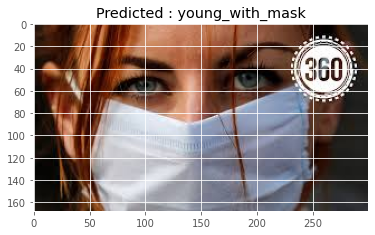

In [ ]:
predict_url('https://encrypted-tbn0.gstatic.com/images?q=tbn%3AANd9GcRRckeXyIInjPtZ_H9OEBbZKbFswUMXBy7n0g&usqp=CAU')

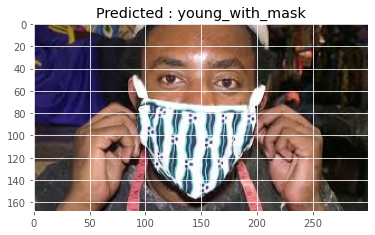

In [ ]:
predict_url('https://encrypted-tbn0.gstatic.com/images?q=tbn%3AANd9GcSwBhLHJc46t8diNIQqp5_TaNHQd6UHRDGkeg&usqp=CAU')

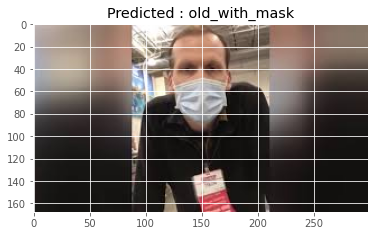

In [ ]:
predict_url('https://encrypted-tbn0.gstatic.com/images?q=tbn%3AANd9GcTcMVt_tkj3Y0XSwDLyf_muHmXmP11DJE-nyQ&usqp=CAU')

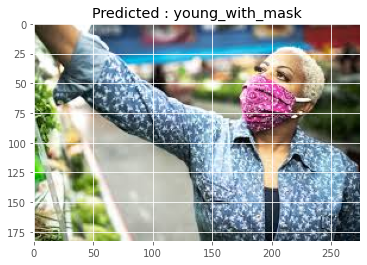

In [ ]:
predict_url('https://encrypted-tbn0.gstatic.com/images?q=tbn%3AANd9GcTPDak9LjqHLB9NE_l_oLihDj1i4uha09SwWg&usqp=CAU')

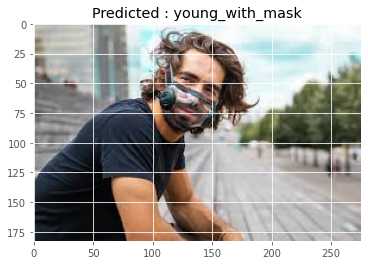

In [ ]:
predict_url('https://encrypted-tbn0.gstatic.com/images?q=tbn%3AANd9GcSoZIPqQvpTg5vhk6zMfHYmiMkzVK5npb8Vag&usqp=CAU')

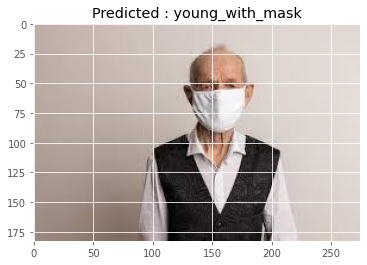

In [ ]:
predict_url('data:image/jpeg;base64,/9j/4AAQSkZJRgABAQAAAQABAAD/2wCEAAkGBxISEhUSEhIVFRUVFxcXFxcVFRUVFhcYFRcXFxcVFxUYHSggGB0lHRcVITEhJSkrLi4uGB8zODMtNygtLisBCgoKDQ0OGg8QFysfHR8rLS0tLSsrKy0tLSstKystLS0tLTAtLSsrKy0tLS4rLSstLystKy0wKys3LTItNys3Lf/AABEIALcBEwMBIgACEQEDEQH/xAAcAAACAgMBAQAAAAAAAAAAAAABAgADBQYHBAj/xAA+EAACAQIDBAcGAwcDBQAAAAAAAQIDEQQhMQUSQVEGYXGBkaHwBxMiMrHBUtHhFCNCYnKCkjOi8SRzssLS/8QAGQEBAQEBAQEAAAAAAAAAAAAAAAECAwQF/8QAHhEBAQACAgMBAQAAAAAAAAAAAAECEQMxEiFBFBP/2gAMAwEAAhEDEQA/ANsGQiGRydjIdCoKAdBFCAwyEQ6AZDIVBQDBAghBGQqGLAwRRkURDCoYAhQAgEIEFAEIAgQJEEIgSEAhCBAhCBAgAkABAhA1hDIVDIy0ZMZCIdAMgihAZBQqGQDoZCIZMBkMIhghkFCoKAdBFQblDBuJKSWb4GpbT6Te9e5RbUVdOVs5Nfh5LLXUlykWS26jY8btKEMr3fIx9Xa0n8qdjCYWKebMtTS8DheW/Hpx4Jr2zeAxO9FXefE9iMBF5XRbT2hOD+K8ocecetc11GseaX1XPPhs9xnCCwldDndwQIAgEhAgQhAgQhAgQgSAAJAgaqhkKFGWjDpiBAcYRBAYYRDAMmMhEMgHChUEBkMhUFBDogqYWBq/T/HuFFQi7b+vYtV428TSdl17u3BfobL7SJf6af4ZtdziaTsl53Ty/Lic83bi7dDwHBf8aL9TIRz07dOowmw8UrreavlfXjlZc3+Zna1kteMX2KTt9zzPbjp66NNW16yiskrvqKae0KcVac0n18e8epOMotxd1b7EppmtkzvSj1ZeGh7EYfo5X3oNcn+n2Mwj3Y9Pm5TVohAFGmRCAiAIQBAgQBAIQBAASWIBqiChUMYaMhhEMgGChUwplDIZCJhuA4yETGTAdBEDcB0MmImNcIZHm2pjlQpVKsk2oRcmlq7HoTK8TRjUhKEleMk4tc01Zgc429t+jjae9CLjOmm3mpLdd1e+TyeuRruEpyja94xcnmuVsrPrdy3C4SOFx6pSefvXB85QzbbXXGz8DqOC2JhvezpuhSUo2lFqNt5N6pXJ43J08pjemgQw+8nKPvotS3bvTqaUs2utGc6HVp1/eupvSW7GGV9YuV3l2+RtUaWHis6UFu3U0433JcLr8L/FpobN0dqb0b6WbVla2WlrdX1JeDfdb/RJ1HK9obPxCk2qMqmasryTtdacn2me2VgazgrUK0N5ZxlB5O1tUreZ064Gx+ea7T9V3053+8wzlCMXvtb70SV81BtppOyvpxM5srESqUoTnHdlJZq97ZtHg2/vftMkk7O1+V3TjbzyMtQhuxjHkkjOG/Oz5F5NeEuvdWoIox2ecSACAUECCBBgBAgQIKAhCEA1IKYoUzLR0wioJAwbiphuAbjXKw3KLExosqTGTAsTGuVphTAsTGTKrjJhFqYxUmOmBqvSnov77EUcTD5k9yp1xaahPtTduxr8JlsFOcoRnJfvKL3J87Lj4WZkcVR95CULtbyautVfSS608+4wezcVL4p/LVh+7xFNaNLSrBcOeXWjWKZe2Q2k1Oamvmtutrj2ozXRWFotLt7zE7Qpq8ZRs4zXDTMzHRqNt/tOjDYEGTSV2Jc8+JqWi5Xz4fn65BGGxMFOs58Fa39Vl9C5CJjI5SadblaYZC3CmVDIIoQCFACAQijAFBAECEIQDUCJihMNHTDcQIFiZGxCXAa5LiMlwLExkypMa4FqkFMqTCn9ii1MZMpTGT9eu/wAuTHTPPvHi2rtuhho71aoo5ZLWUrZ/DFZsIzFzmW1Olu7tCco2UIKMN5L5snfftqnl2WXI2nHbeVSinTTSqK93k93TRPjfmaDt/ZVsTVS/i3ZdzUc/Bkt01jNuk7H2nTqpJNW1S4WeeRs+zko/K1p9jiOAr1MO0qbyTckmrq1m9eGdnlY3Kj0nrU6am6SavFZSt80lG+aeRqck+n8svjp/v12+uox2JxG+9cuFtDV8ZtWq4Sc5fCr2gsr2dkm9Xd28TZ6OFe5DP4tyN+Xypd2gmfl0mXH4TdImFGOxG1qNOt+zzqKFVpNRleO8ne25Jq0tHo+B7osrK1MYrTHTAYIoQGCBBAIUAIBDcAQCQFwgaYmFMruG5hpamC4iYbgPclxLkbAbeBcS5LgWKQ28U3G3gLVIZSKbhUgLd4wu3OlmGwt4znvTX8EPil38I977jz9OMTOGCquDlGVl8UW00lJN5rquu84va5qRm3TdNr+0bEVG40UqMNLxalU/wApKy7Er9ZqeKxrm96W83ndyk5N3VtXne3MrVNXTd8wyprXmb0w6J0JqyrYOzXy1pQg9cm/ePw37dxuu3NiqpSp4hLNU3CduvOL7s14Gr9D8Th6GDwsalWEZSc5qLkt6TqSe6lHXRxRuOG6VYVfuKnvFGp8O842ir6Nu+XgZym3TG6003D4PfpRlb5XKLy5Wil5+Fz2Yqj/ANO0891Zc8mnw45I2TZmxfdRqRlnvTby5Wsmvr3njxtCLlCC03ouXKyz+x4rl70+jjjNKcbLeq06KWV992f4GprxlurvOi7rjGL6rfoaL0ew+/iZVX8q+Fdizfnur+1myz21WWUsM93LOE96S/taV/E9XDNY7eLnu8tOQ+13Et7Qcc7Ro013veeV7rSWls7mG2T0xxeGklCpJwtnCp8cG082k/l1XytHr9oeLoVsdKtQqqpCrCnJvP4Go+7cGno1uJ24bxqtWKc1bVPsWdv08Dq4OydG/aThq9oVl7ippeTvTb/r/h/uy62bvCV7NZp6W+x8y+5eV9ePUZzo50kxmElGFGpenvK9OSUoO7V0r5wvfhYml2+gkxkVoYinuEUZAG4QBAKCAIBuQBANKuS4lyXMNLES4iYbhTXA2LcDYDbwN4rcgbwFu8NvFCYVIC/eJKdld8MypTK8TO0Jf0v6AeR4d4jC1KUs9+DS/wC5NN+F1L0jjEKemVrHcsNHcqUafJUvF++X/scc2hQUK9ak8rVZdlt5/wD0dI515YvLMjXmWVaSWXr1lcSVvX58CoporckpRykmpJ9cWmn5HbsNhaeMw9OtFWVSCl/TLiu6Sa7ji7XB+frTI6X7H9rJqphJvT97Tu+DsqkfHdlb+ZhZ6bjha9SjuwnnTtu3/A+af4erhw5HnxFJzqKlB/FN68la7l4eszZKlGNmpK6fj1NPgxOjmzVeVey4wg7axi3fLTX6JKySS5Z8Myu3fDmuMsXdH8HGnBxcWpJ2d878mnytYXpVtD9nwletxhTlu/1NWiv8mjJ3Od+2XaajQpYa/wDqz35f0Us//Jxf9rOrjfftx9Lq4a/qV043d/qWuTXr79txsNTyv2eYZNuO/rwRn+hGA99jsPTeimpyXVT+Np8r2tfrMDF25dj0tysuw6D7IMFfEVa+doKNJX1vO85Lrsox/wAwOntWbXJsZBxK+J9YqMtHQwgwDBFCAwRUFANYgEQDRg3FbBcw0e5GxLkYUd4VyA2K2BJSBviSYjkBdvB3ijeCpgXqQlV3tH8TivNX8ribxdhFvVI9V5eCt9xOxNoz3cTTfXR8qln5SOXe0Gh7rG1Fwk2++7T8rHT+kcXlNaxV/B3+xq3tg2bdLELnF36prPz3TpGL00GNTe0efrn/AGFjS9eOd0YrDzaZlaMVbXus/B5vkVgHDhyflx+h6NlY+eGr068Nac725x0lFvrTcb9ZQ+PrS97eBXGV9LPg87LLseYV9H4fFxqUVUg7wlT34vmnG6M/suG7RpR5U4L/AGq78Tknsr217yhVw0mr0ozlBZ/JNO6z5Sf+5HXcI1uRtyX0LFrznCvaHtL9pxtWSl8NO1KFm9IN7zsv5nLXVI630u2v+yYStWvaSTjD+uXwx8G79iPn/wB3lfV+b1463yfVkQVKyedte7tWeXhxPVBqKV9GuWuhXUh8t83mn3OxIwvG7kkksr520eWerf0YQZVVbJW8eeXBHZfZrs/3OAoSatKq5Vn1qbtB/wCEYPvON4LAyr1KdCN96rOMFZZpzdt7uzl3M+jYUoxcacFaMFGKXJRVkvBBYvxsdH2rzPOj2YtXj2P19TxIlWLAoRMZMinRBUwhDBAiXAYgN4AGi3BcDYrZhs9wXEuRsAuQspCtiSYBlIRyFlIRyCm3hlIocgqRBfvHv2N87fJfX/gxW8ZXYuknzf0RrHtKt2rS3oXXJ5rs4nk6RYNYnZ8IvWVPdvyklaL7mkzK+7aVv1T7Tw0n/wBJKGXwSks+vNHRlwCKaeeqea7Ge3BVmn67vXaU7SjatUX88n4u/wByJcdPIOb3OeXHg/JcfXzAlL8V32/ksnx8SqjU9fXuLVO2Vss125W/LwCsl0b2nLC4inWUrxTtNLRwkrTilzs8tM0j6S2XVThFp3TjFprRpxWZ8uuz07vz78zq/s76YRpbPqqq1fCq8U8nKEvkiutS+HqW6WDGe13be/iFhou8KPxStxqSTy7ov/ezQ6abTs09P4rPsSt12uTF4uVSpKrUzlOTlLhnJtvPhrlcVtX0eWb5q1+WvrMgM4Svnm8/Hjn3k908pN6vLz7l60DCo0msrc35ccjx1KmdvLrbA6F7J8Bv4n9oksqEXu8Fv1Lxj4R9515o65h/mT5vM0T2V0VHC2tacpSqSutdIpJ9Vvqb3hk95d5Wnumrxa6jHJmRjNGOkrNrkzNIZDCJhIp0FMRDXAZBETCmAxAEA0NiNhbFbMNJcjYrYGwI2I2FsrkyKEmVyYZMqbALkBSEkwJgXKRmMB8sV1X8X+pgkzJ7MrZp8FZPssjWKVnqd7J93rxMfXW6qy5re8NfuZOjHK30f2Mdj8r9aaOjLgu1/wDXqf1MpTLts5Yir1SaKo9n2Dmsg+PA9NOX5eBXTjk7/n2/csjHL1YKtTsvXBLL6iRnxvlp23187eBXUlaLfaWUb7ri5fC1G6srtq9s7aXd/AAuXG/jmv07x8reWWevIEVbS/pIMewCbq5u/XYlGXGyV/Hx1Hm0/wA/z8inezy9fp1AdH9m9e0Gm2nd2zcb/E8u3LwZ0vYGJdSipN3d5K7/AJZNL6HLo1o4evFRf+rhsPUkuCmqMYu3W1GD7zo3Qtt4SnJ/xOcu6U215Br42CJ58Ws780XqVivE5xvyf1FHmTGTEGTMKYKFuG42GCKEoNyCkA0NitkIYaKwXIQikkVykQgFbZVJkIAjYqYSAFMmzK7jPqf2IQuI3XBZxT42MdtXLzAQ6sOE7elfE1bfjflkJhqi9akIHNb3/nzGlU3Vd6IhAKKlS8LrRrmz0qeS9akIUWqqmu8qnJ6r1kQhFWOfwu2qPNLPTXh220IQDd+mtCX7XGEHmnTpLqUacKf2bOwbMiqVCnBaQjFd1rBII0zFOKZMRD4XkEhUY5MKYSHJtBkAgBQbkIEEhCF2P//Z')

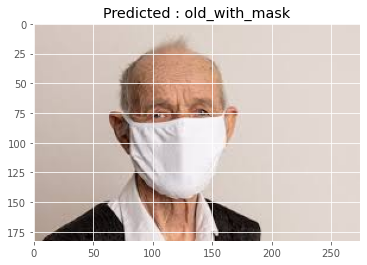

In [ ]:
predict_url('data:image/jpeg;base64,/9j/4AAQSkZJRgABAQAAAQABAAD/2wCEAAkGBxAQEhUQEBAPFRAWFRAVFQ8QDw8PDxAQFRUWFhUVFRUYHSggGBolGxUVITEhJSkrLi4vGB8zODMsNygtLisBCgoKDg0OGhAQFS8dHSUuLS0tLTAtNS0tLS0tLSstLS0tKy0rKy0tLS0tKy0tLS0tLS0tKy0tKy0tLS0tKy0tLf/AABEIALcBEwMBIgACEQEDEQH/xAAcAAACAgMBAQAAAAAAAAAAAAAAAQIFAwQGBwj/xAA4EAACAQIDBQUGBgIDAQEAAAAAAQIDEQQhMQUSQVFhBiJxgZETMqGxwfAHFCNCUtFicpLh8YJj/8QAGQEBAQEBAQEAAAAAAAAAAAAAAAEDAgQF/8QAIhEBAQACAgICAwEBAAAAAAAAAAECEQMxEiETQSMyUWEE/9oADAMBAAIRAxEAPwD0FMBDMmySASGAwEMB3AQwGMQICSGiKGghoYiM5pATGazxCWV/PhYwvHpysnlxJtdN8DHSqXzMpUAIEMAAAAYABQwAEAAAwEMAAAAAAQwAQDACuuNMiO5FMkmRQwJAIAGMiMBtjEFwJDcjHUqKKcpNJJNtvJJI5PHbelWbjSvGlop5qU+duSJbpZja6PFbShC6ur8rlLX2u5PIq4u+upmhSWv/AEY5cj0YcP8AW1+YnK+YUpNfUnCJOMc8zPzrX4ou8DiU0lfP0N6LOb37czNSxs4c7cszXHln2wz4L9L8ZoYXaMZPdbtJ6J5b3g+JvI2l2wss7NDEgCGMSAoYAADAQwAAAAAAAAAAAAACsQyJK5FMkRBASuAhgMBDuAzWxuMhSg5zkopat8DO2cJ23xjlJU1azXC7Td7fUlI0Nq7YqYmrbel7KL093eXC6XEzUZvhmumpR0alm31+JY0JtuPXguhhnXp45pb0ZN5J3vrzXTI3qd+D8rPedufI0sI7vV2WeX3YsKXC6624LxZk9EZYxfp0MsI2XF+nHqRjlllfrdGSMW+Hz+iRHQinfXytdhUfS79LrxJ06ejy9GZJU19sliNGo45a5vWPDr0L3ZGJcluy1jlfnyZVSinZ8PUz4Gpu1Y2euT8zTiz1dMObDc2vwAZ7HjAAADAQwGgEMAABgAAACAYAIYABUkrkRkVK4yNxgNDI3GAwEFwJHmnaSO7iZRyzzSWivn9D0eo8jzXtDUf5pp9Lvlmv7+BKsUUqtuHX1y+pvbLqNJRbbfPnfVeCK3FytLw/q5YYWO9FS52y5vi/VmGT04OhwVfx62yXQtMM1pZ34XbSa+vAo6MXrxtm75FthGn3VJNqzV+BlXoi0nHzSS4a68Ce6o5rdt5LzHh7Stmnwb5GKs/030fw3rMjpmotJu1k+V7LPMyyb5GpKSi73srLPoT/ADNN576fDO2TAJLjbUxt2mn1Xn0MkakZaNXNXHztZ6Z5PqMe3HJ+rroSuk+hI1tnVN6CNlHuj5pgAFDAQwBDEMBgIYAAAAAAAAAAFQMgSuRUrgiKYyCQEbhconcCNwbAkzzHtTSkq83o9V6/+lhHtxJ1Gt+nBXe7CULZcFvPV26k8VjIYxN7sPaw95RfvRfu5PTR8Tjyluml47jN1xm0qV5el1y0dvib+AqKNNX4ZfG7+cSFak5znpvXa3d60nyt98SUcPNUlHdkpb0r5ZbuX9GeVbYz1tu08W3lFTb6aNsUsRWi84qK/km38eAVMeqUJbkZOy3VuLvSutb8Fk82buCVWVF1Y1IqKVN+ynT3ZXlG8kry71nlfj8Caut6d+t6t9tvY220nuu+T1TvfxLXZGJdVVcslKUbXV87v6nI7QbhKnVSSee8s1vXXFPTV+hfdlarUZWUm5aqN5Ny6paGWU+2s30yY/FyprdlF72iT1aKz8vOdp5eEZWlboXO0MDKcnNqcWknfcd2tMstSgxWxpzlFqEpLPejKU6cm2pZqSs002nfodYY7/xznZJvtb4ZTi4y7zXPO653LDaHfhdPS71XCxp7E2djYR3KsK1RWjaooSlJ84ysuHCXHj1v8LsWvPJ05qPOpHd3U9XnrxHjlvpz5Y67ZtkYuFOlH2kkrrjdvplqXFGrGa3otNc0cxXU3KpGF4Ri5Ri8naMMlb0v5m32Sp1lGbqzck5LdbSTfO9jbHk3l4sc+GTDy37dAAgNnmMYhgAxDABiGAAAAAAAAAABSpjTMaZJM5VJMdyI7gSTAimMBjI3C5R5D2r2U4VnTtmpSafBwfuP0aK/Y9WrQqKpGd5Ryd84Sg7OUXzWXyPQe3+CvGlXt7knCbWu5PR+Ukv+R5xi8TCH6d7SbtZcF1ZnJqt7l5YvTcPsTD42nDENTpylFPeik3Zq9pZNO3M2afYuMsvzMmv9OHLKXyH+G1dPDxoyzvTT+LT+heUZuhXUZPuWsn10NvDHL3Yw88sfUqso9jqcfdq28ILPPjd5m2uy9L91Wo+i3Y/Rl/Xw2/BqDs9Yvk9TS/Mqr+nPuVo5p9fqh8WH8X5+T+tWHZ/B03vSoxnJcal6lvJ5L0OhwMVFJQjFK+kUkrcMkU08S3eNSO7Nqzks4S/ottkTvFZ6HcknTO23urLeC5FjSK5NsjNkiEwOMx8d2pUhorz9L7y+Zv7Khamubbf36Gttqi3iZdVBJdWld/AsoR3UlySR48MfyZV7eTL8WMTAQzd5jGIAGMSGAAAAMAAAAAAAAAKG4yCGjlU7gRY0wJIdyFx3AkmMhckgMWMw0KsJUpq8Jpxa6P6njO3tjyw9WdGortZwqW1jwkj2wo+1ewli6XdS9tC7g9N5cYPo/mTKbd4ZaVXZJyo4fC19Vu7smuV3md3jIKolJcsmUnZPBKWCjRqrcnG8HCWTg76P4epZ7E3lvUJ+9DR84PRm2PTLLtY7OxD3TX2th4zcZxylzXJk3ScJXWktVykv7IVZX9Tpy15JvXwLPZMbZGhb76FjsyV2BaIkJDCJIjYkjBi6+6nbX6gU2JpXrym+Cil42u/mTEm+Lz5jMZNNbdmMQFQxiQwGgEMBgIYDAQwAAEAwAAOduO5juSucukkx3IXHcDJcLkLjuBJMlcxpkkwjImSMaZKLAptpYueErrERipQmlGpBq+8lrbrb1LrEYaNSEMThpaWlFJ3Ti9Uv6Of7bbRp4egp1Ffvwatqldbz9GPs/tZYeyvfCzzUln7Ny4/6s7xqWOvwGKVVJtWaykupDG093PgYq0HTkq1Ozi7byXFc11N3ESjOOWjzTNHDRib+ytTSira9Df2crMC1QxITCCcrczQ2i81Hlfzf3c2nP/rx5lZXneTOcqsRQ0RJGbsIYhoB3GRQyhoAGADBAAAAAMQAAwEMDmbjTMdxpnLpkBMhcdwJ3HcgmCYGRMaMaY0wM0WOU1FNt5LNmJM1sZJy7q0WviVHI9vIyr4erN6RUWlyjGSZzmwttyoTVOdnQndZvKnJ5ej48teZ6PW2cq0KlF6Tpzj5tNHl88E92zVpLJr/ACV0/ipI4yutNMJ5bj1bYG1dxKlN3h+1vWN/2svqVRZr4dDxXZu1q2GtGV50slZ+9Ff4v6M77Y22FOKlGW8vHNeK4M1xzlcZ8djtVTujYwsbMq8JtCMlf142LCliV98TTbLSyhLMlORqxxBhqYyN2lJSkrNxUk3FPRvkS00ljK2Vk9fWxpIJybzBGdu3ciQISYyCSYIQ0A0MiSKGMiNAMaEADGIEAAMQBYAGByiYzGmSTOXSYJkLhcislwuQuV+2NtUMJDfrTSv7sFnUm/8AGP10CLPfKjF9qsHSnGn7XfqSdowoxlWk5cu4mrnm3aXthWxd4RvTo5/pxl3pL/NrXw0OawuNq0ZxqUpuM4tOMo/taz++Z3MXNyfR2GoSmm7NWV3e2V1o+pr0qf6d/C75t6mr+H3auntGgou0cTDOvTWV29JwX8X8NC3hRvGS/jOafRJ3XwaOtG2CnGzT6I5XtjsVQlKcF3Knf8JP3l5S73mdWuBtVcGsRRlTdt5ZxfXl4PQ4zx3HfHl45e3lf5JSjyvztkzQxOzd2WWWStzvwOgoUHGc6Ul7ratLK2Zu7QwGW8+luOfA8u9PbrcVOy9s4mlNU24zi723k4yytdXi/mmXz27iaabhSg0ldQlKV/KS/opJ0bVKXNNu/NPl8S+qZRvbhp8i/JlOknFje4scPt2piKUWlGMZq7sm5W4q70DsRU36uIm/ddRwS4bsYqPzSKfs9JrD58HU8le/yLjsHC1CnL+SlUfVzbfyZ3x227rPlxmM1GnW7brCYqeD2hT9k4u8MRDelSqUn7k3HWN1bmk0+R0+z9o0cRHfoVadSPOnNSXnbQ5P8aNhqthYY2C/VoO03/KhNpP0lZ+p4zgsbWoT9pRqThNZqcJOMl0fPwPRp49vp1MaZ5D2b/FSrHuY2HtFe3tqaUai8Y6S8rHpmxttYfFw9ph6sZrik7Ti+UovNEVZ3GiCJJkEhoiNASGRJFDAQwGAhgAxAAAAAcemSTMaZJM4dp3IzqRinKTUYrNyk0klzbZQdou1VHCJxX6lb+EX3Yf7v6a+B5rtntFiMTJupOW7wgnuwj4RXz1LJtLlp2vaHt7CC3MJuylxrST3V/rH93i8vE86x2PqVpOpOUpTespNt/0l0Rgcrsx5X1+CNJNM7diUm/vNCu9fJ9VzJwjfThrfgtGgivi7csyosOzu2K2BrwxFJ9+Ms4vKNSDWcJdGvjZ8D3/s1tenjPaTou9OapVFfWO8nGSlyacGmuh85RpvTPhzyaXF/A9L/BLEyWIr0rtRlShPd4JxnZtf80CPSsTT3X96m5s9tZ8OZix8M7LiblCC3Ulw+LDpzfbzZO7bG01xSrJcYvJT8nb5mtCj7WkrZvLP43O5lSjUg6c0nGScZRejTyaORo7Nlh3Kg7uKTcZuz3ovR6a8H1V+J5efD7j1/wDPybnjVAsOpyckss93w0XhkbLoWVvTmb8MJm9cjFiqLjHevZ5LxzR59vXIrsInHCtaNRrLzvJHQdlIqng4P/8AKlCPjZWKzbVHdpS6xb82iz2Gr0KMb92MISfWW7kjfhefni9xGz44nDVcPU92pTnTfRSja/ldeh8zV8JOlOVKa78HOElf90W4teTPqShVjGG/NxhC2bk0orxbPD/xc2bGjjVWptOGIjvd3O1SLUZ+F7wfi2ep4a4DENRadnxT+aZmw+InSkqlKc4TWkoScH6rQlioxtnyeXF6aGCMHLO/FXdv2vmvJhHoXZv8UK1K1PGRdaCy9rBJV146KXwfiel7B7S4THJvD1VJpXlTknCpFdYvO3U+d5005OzdvD5fEt+yuJnhsXRqxfuzgpa505tRmn/8t+aRLF2+ibkkQJI5VIYhoBjEBQxiABgAgGAABxN7Hm/aXtxOpKVKhN06ScouaT36iWTel458F58gAmMXK6cjUnyeWb8b6mCo+eXxQgNGaTi13vUniIXS3Wv/AB5WYABlw0G00836W1z++RKdG8s9U78LZ6gAEXG2vvNaftbO2/CGq47Rs9Hh6y8WpU3pw0YAB7VXjd3M+FXduIArbp6kNoYRTje3eje3O3FffIAJlNzVXG2Xcc3BpNrhwds8v/DWxn6llwTQgPlbfYxiW3I2pO/8beORs7Go7kFBpbyhGPRNJJ/IYHq4O3l5/wBYtsZhFVoypSzTVnflqfPXaHa+IxElRquLWGlWp02laTjvpNzd83aMcxget4VHiUnFqz4NN5524+g8NNXSu87ZgBUZVF72ml3m0/Et9gU9+tSWqlVorr3ppfUAJSPoMkgA4dJDEADGgAoYAAAAAAAAAf/Z')

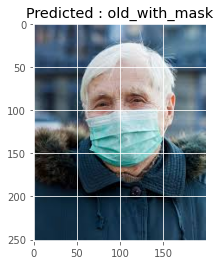

In [ ]:
predict_url('https://encrypted-tbn0.gstatic.com/images?q=tbn%3AANd9GcQVcDQhx272z7snpAH0oawYnyUR3FV5fVOc5g&usqp=CAU')

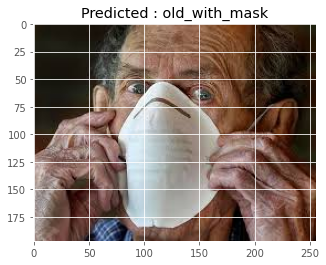

In [ ]:
predict_url('https://encrypted-tbn0.gstatic.com/images?q=tbn%3AANd9GcSGtZzW0atElyg1sl05QXo2X7MR-RZ5bgiMDQ&usqp=CAU')

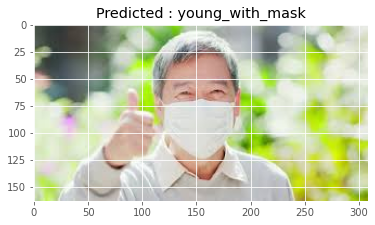

In [ ]:
predict_url('https://encrypted-tbn0.gstatic.com/images?q=tbn%3AANd9GcSDFhdxnUbUJorEJyQyIABBDZpq3fHAV0BeVw&usqp=CAU')

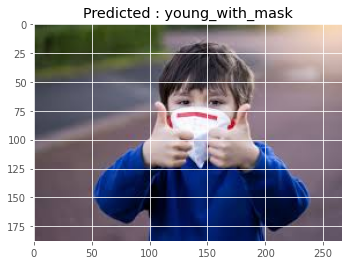

In [ ]:
predict_url('https://encrypted-tbn0.gstatic.com/images?q=tbn%3AANd9GcQPeJvUjhVX4FuXLVzlVpuLhqixNMCB9zLmsA&usqp=CAU')

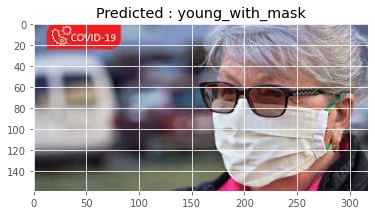

In [ ]:
predict_url('https://encrypted-tbn0.gstatic.com/images?q=tbn%3AANd9GcQGX0kwRhvaM5RD9pxon_GsXxL8tGKZ_qgnUQ&usqp=CAU')

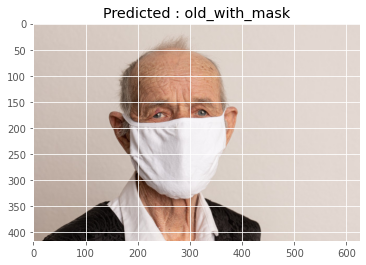

In [ ]:
predict_url('https://image.freepik.com/free-photo/portrait-old-man-80-years-old-medical-mask-concept-danger-coronavirus-elderly_203900-148.jpg')

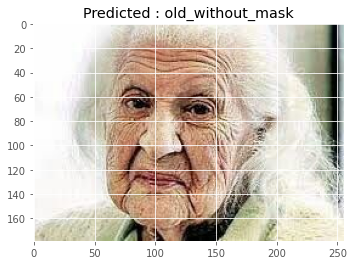

In [ ]:
predict_url('https://i.pinimg.com/originals/db/00/0e/db000e66cc61d4f15a6c2b04916bfc9c.jpg')

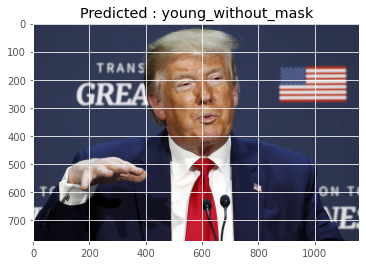

In [ ]:
predict_url('https://static.politico.com/dims4/default/da9bc8b/2147483647/resize/1160x%3E/quality/90/?url=https%3A%2F%2Fstatic.politico.com%2F1e%2Fa1%2F903af18a4ee9b8cc1652edf4b9c0%2F200612-trump-ap-773.jpg')

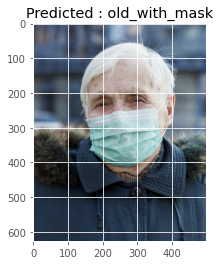

In [ ]:
predict_url('https://image.freepik.com/free-photo/portrait-older-woman-wearing-medical-mask-while-city_23-2148492324.jpg')

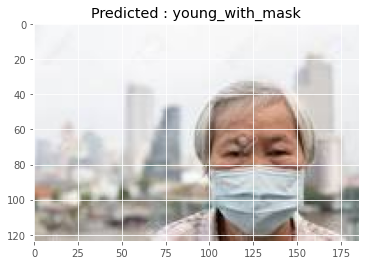

In [ ]:
predict_url('data:image/jpeg;base64,/9j/4AAQSkZJRgABAQAAAQABAAD/2wCEAAkGBwgHBgkIBwgKCgkLDRYPDQwMDRsUFRAWIB0iIiAdHx8kKDQsJCYxJx8fLT0tMTU3Ojo6Iys/RD84QzQ5OjcBCgoKDQwNGg8PGjclHyU3Nzc3Nzc3Nzc3Nzc3Nzc3Nzc3Nzc3Nzc3Nzc3Nzc3Nzc3Nzc3Nzc3Nzc3Nzc3Nzc3N//AABEIAHwAugMBIgACEQEDEQH/xAAbAAABBQEBAAAAAAAAAAAAAAAFAQIDBAYAB//EADwQAAIBAwMBBQQIBQIHAAAAAAECAwAEEQUSITEGE0FRYSIjMnEUQlKBkaGx0RUzweHwcvEWJDRDYnOy/8QAGAEAAwEBAAAAAAAAAAAAAAAAAAECAwT/xAAfEQEBAAICAgMBAAAAAAAAAAAAAQIRAyESMRNBUSL/2gAMAwEAAhEDEQA/APZkGKkpqjFIzYpkcW5xXUxfWn0B1LSUtAdS0lcaDdkUtJtwOaRTSB+aQ11JQC11dSUAtITikZsU0cmgH5rqaTSZoB2a4mm5pC1MHZrsimE+VdjjJonYPzTaQHwpaCOY4FMAzyafmuzQZK6urqCKDS02lzQDqT18aQmlBoN2c+FLSV2aAWupM12aAWmscDzrs03NAIMmlpOBTS4HjQR9dTA4NOzQHUL1CeRZlWMgVav5+5iyBzQJJXlnO85os6OCttcsX944ogjhxkc+RoEV+dFNMJ+jjmlBVuurq6mRa6upKAdSV1JQDs0lJS0aCtfTGGLcKrw3zlASKfqn8tfnVcAbBxRTEYJxL4c1NmqNrw3HlU8txFF8bgUEmzXZqGKeOUewwNPzQDuaq3F7FCSuQzjwzjFUtb1ZdPgkKglkXc7ZxsFYD+P3924aJFAY4XvFBI9am5SKmO2yudXcsdz7cdORg/eKpDU7jdxN08BJyfuoKi3s4LXFwMdeFAxUsFrEctIoKqPreJrO5tZx7Hotbmxh4pCufj4xRKw1aOd+7IIfHQispNOFQpGu7PQY6+v5VEPpiYnyysntjzJpfLIucNrbaj7xAPqnxoYkAV92auadfx39kj55cYI8mpkqbTitPLbDx0jFEtNPuD86G0Q03+QfnThVdzXbqaaSqSfmkzSUjHANALu5xnmlzQzvJDcg+FXZZ1iXLUSnZpMDS5qCCZZRlTU1MlTUvhFQf9sVNqPwiogPdilTWIDtyT5VjtauGm1FlV2KA4xmtJf3Jt7fIPJGKycce6d38zmqxTk0vZviNhz95ovdTC3geU87RwPM+FCezpyj/OpNfuO6EK54yzfhwPzNLKiM92ruAth3bnLSNl/U/wCf0oVYQoiq0jAnHAzQ7tlel7uONfhQjxqSGSR4vYGSR4eArlzydnFj0LvdKBjcADznNNE4fG7ATw5qjFAi5Mh2DxLGpWR41ysylCPPisbXVMYKRyRp8Jz88Zpkl6uSM/PNC4tpz7znPhTmWIniRM/Oo7Xpc0fURbai9rvKrON0YPg4/tWnjuROFOeW8PIjqK8z7QSyWAgu14aGQEn0zWvsb0Pbd+nw5WT8+a6OPLpxc+GqPZq9ppzE3zqgPa5UcHpV7T8pEwYY5rojmq7SUwHk0tUlTluZFmKqeKnWcd1ucUKmlzcMRThM5wAeDVURc4DfFz1x5UyYGVck/DUE1yIFGRkmmtqkQj2hDub0rOS7Vlfo6CRlkGCevhRmMgqDmgEEgZsjxq+sm0jc3FVknGJdRIwBmkhXegFUr2YtKPKrKyCG0MrdMVNqpATtLcmF1hByCKERS4jzuNN1S8S9ut5bgVHG8TjYpya0npnfbVdmJN8behqr2zkMbWzc42tz68U7stuj7z50/tXZTanph+j/AM2FtwH2h4j8KjKqxjy7Wy1zrsUC59uTn5AZo2zvHGILVcMer4qC30/fq4un+FN3U+Jx/en6tpV3Llba4ESHk4GWrkzv9O/in8q0kt9p92txeMk8BXGOu0/Kmy3hZjICyq3KRAY49fIelCH0C/idnuNUlkjPRHYnB86LaZpTh3a5mMjN0bGPypWyReMy2DXF3cxz90kjKT05opp+lSBO/nv2kJHTqo+ddrfZ+Sb3iTNFtHJjGSaFad2YtpZu8k1W4wfqxMRSmtKsu/TTX9qb3TZLeUq7MmEYGnaBeGPQSJTho4yh88jg/mDVvS9Nis4iq3Mkv/txnH3VRurba7wQqT3sxKY9ev508L2z551tsLK6lcgB12YGOPSjaq6wq4aszpDYlK8EfDWqUf8ALLXVpxrMfwA+lOzUUbDaBmn7hVswZO7R2duc07voXICcGgMt9I/wk4qNbspjL4Y+FZ/JjftreO492D1xEJbhEY8VfXTrd0x41mUupmlXZudvDFEVvbpl5XaRxzT8tIq88Ahl2pgior3vWXCjkVZtImYrK5yDVi6tt4Lq2MUS7F6CC2YxuPtUup36x6Wyr8WKDx6hFPqT23eDcrbcZqt2nhuLdFIf2CegFK38L6U7QqrF2XdmpTcCOTMcQq/2f04z2yvO2ARmiM2n2cERywNV5/sKYfiPs5JcXkzpFhAOtauOzkjTJOT41jbbU4NKlaS3G4t1olB2juJ8OUUJ5edT5430vxyA7vTX/il1udoUdN0O0D28McnHzb/OKjOgzZBbVVUnwYID+HNaB7+LU7wrJHh4kOxseeMj9PwpkRmib2WUHA9krwaeOGOU3oXlzwupdBtt2asN4eRzNKPrGQ/oFxRW30WygYSJCCw8Wyf1P9KtwSzycLBsP2x+1TOCoxhmPjxVfHjPpN5s77qjc6daTHc9sOfrBc//ACRQW57L2BZmiLQMerKWH6qa1Kg46eyfyqvO5hPtKdnmKPDH8E5c56rJy9nBGV+i6lLn/wAtrA/jikurcWczRh2b3a8tjPrWpS2YhpJsHxQFsj51i+0N6ItYmiP1dvT5CpuOOPavlzy6tEtFPvfvraL/ANNWH7PkyuGXxPnWyknENpuYjgc80W7MwTrHncaZ9NX7ZrOXfaC1FwwPIXg1H/xNY/ZP4U5S1j+odAtGu7MSSy7c+tNutKnTUldHDQjrzSra/RYSgmKZ5qrA968rhZsqvnWMwx+ml5MsprKttpUlmiqCY92B1NZjtZeSLqQW0kG0jnHTOaE35uwu+OQ9cHFTxoEtC8o3yEdSeaL30iyC66ncxaeiRH3uB16VPb6vc/RGSZl7wjAoNZXSLCA8bZHpXQ3ELXYDsVB860xK46CV027TU2uyRu37gRRe9v5bkBJVBAFW77VdNsgFmcZPTBqlHr+lyHuxilJZ6EkSW93NFCEjPHlSNqKBD3ynPjzTZLmCQ+5Hs9aqyTxSAr3fpTs3E71ek8E9lcbjh1xyatW1zYd3tE5Bz4mhGmQvLcSJFGz5H1R0+flV1ezghbvL27ih3DMaLIDuPkT0H50vGaVLkJWdzBHfERy7n7s8Zq4ouLlAVnIbr7OP2qr9BtNOsbjUHjRpkhIGGLbSR5+dYrsF2jfUoZ7S4kkS+hcmOUP/ADEz0+Y6eoxWuFk6jLPHO91tru11CUbXv7naeMK+P0qO3sbm3O9byUY6lm3frUP8T1GM4Z0l9ZF5/EUsl+ZgFnhYJn2u7c/tWjPRZU1SS5Zm1N0Qn2Nv9quw22vgAJqm4eTqCPzFV5dXtLGMbYIy+OAWLH+lDZe02py8Wyxw+RVcn86W1aaiKLUIoS15dhwPBYwB+Neddr2n/j9yyQvtbacgEj4RWq0RLrWpbqKbU5HuoUBEbNkKx+HcPKhd3d3kLy217aosqnBzzWWdlXjjtmbTVbuzcCORoz5Gtfpkt5fac8k0rNkcYPWsrqFg99OrL7H+mjWlWmowWfcx3JVPLxqZperIq3OnXUayPJjDdOao/QZftUWvGmRdk9xlQOhqkMEA9/19a0Za/Wv1KxFxDuRvaUcc1moYtSErY9gdCa1MeWQAk9KtxxR938A56/lWMjoZVTPH7t1JU+dWrZXYAMjEfKjbW8THlRU0cSDgKKcKh6wJtOIjyKBaj2cmuW3RyMnPga2QAA6CkcAjpVEwS9n5u8Uzbn29CTmrMXZ5GlLNHxjwFa11HkKRQME4pbqpQqDR5o+7VIl54Vcf5+NGLPs5bxAtODJN9hvgA9cdaJ6QBIpLgEg8Gr9ycxsPs9KqXpMk2ppBZ28LDaAMYKL7K/co4/rWe1KNRdwrbssEGegQZ/2qe6nkM24seOgps7sl1Dt8f2qZd1rcdK3aFnbR7kFg2QQ3GPlXi2glrTW5QqlMSOuB4c9K9y1xFOlTZUH0NeK6hEtr2ivBDkATAj0yB+9LkPj9t5Z6qxIW4O5MZEnl86uXF2I48Ickj4l/Ws1atgSJgFcZx55FUp5pUYmORk/0n0FTjy2TsZ8Et6aIOGYtJk+ZNQS6mJJe7tMBF+KTxPoKzbXE8xCyzOwI6E1csvYA21OfLbNQ+Pgkv9NH2Qlnt+2VzOuTHPbKrc/WXp86319bQXlvHJcRh0jJ3KF9on9fw86xXZSGNtWSVkBkEaYbxGWbP6V6GoCRZCg555p4dxXLJMmaGgQMomtpdhLYEcozj7xU76fPariSML68HPrkUbv41ijknjJWQEjI/GmaS5ubQiQDac7lAwG+6rkZWdbZK8sYZ7Z3kX2s4pq6fabR7pennRfXoVtpJkjzt2ggHwoWsh2jp0q3Pfb/2Q==')

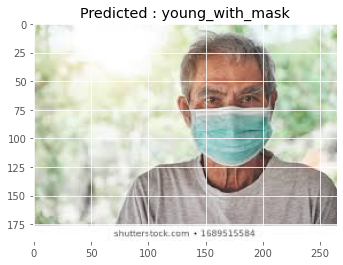

In [ ]:
predict_url('https://encrypted-tbn0.gstatic.com/images?q=tbn%3AANd9GcQmIZ3-SxmF6Qf5Q9rtNkDBnGxoTItsBMlJiQ&usqp=CAU')

**Video Prediction**

In [ ]:
from tensorflow.keras.preprocessing.image import img_to_array
from imutils.video import VideoStream
from imutils.video import FileVideoStream
from google.colab.patches import cv2_imshow
import imutils
import time

In [ ]:
def detect_and_predict_mask(frame, faceNet, maskNet):
	# grab the dimensions of the frame and then construct a blob
	# from it
	(h, w) = frame.shape[:2]
	blob = cv2.dnn.blobFromImage(frame, 1.0, (300, 300),
		(104.0, 177.0, 123.0))

	# pass the blob through the network and obtain the face detections
	faceNet.setInput(blob)
	detections = faceNet.forward()

	# initialize our list of faces, their corresponding locations,
	# and the list of predictions from our face mask network
	faces = []
	locs = []
	preds = []

	# loop over the detections
	for i in range(0, detections.shape[2]):
		# extract the confidence (i.e., probability) associated with
		# the detection
		confidence = detections[0, 0, i, 4]

		# filter out weak detections by ensuring the confidence is
		# greater than the minimum confidence
		if confidence > 0.2:
			# compute the (x, y)-coordinates of the bounding box for
			# the object
			box = detections[0, 0, i, 3:7] * np.array([w, h, w, h])
			(startX, startY, endX, endY) = box.astype("int")

			# ensure the bounding boxes fall within the dimensions of
			# the frame
			(startX, startY) = (max(0, startX), max(0, startY))
			(endX, endY) = (min(w - 1, endX), min(h - 1, endY))

			# extract the face ROI, convert it from BGR to RGB channel
			# ordering, resize it to 224x224, and preprocess it
			face = frame[startY:endY, startX:endX]
			face = cv2.cvtColor(face, cv2.COLOR_BGR2RGB)
			face = cv2.resize(face, (224, 224))
			face = img_to_array(face)
			face = preprocess_input(face)

			# add the face and bounding boxes to their respective
			# lists
			faces.append(face)
			locs.append((startX, startY, endX, endY))

	# only make a predictions if at least one face was detected
	if len(faces) > 0:
		# for faster inference we'll make batch predictions on *all*
		# faces at the same time rather than one-by-one predictions
		# in the above `for` loop
		faces = np.array(faces, dtype="float32")
		preds = maskNet.predict(faces, batch_size=32)

	# return a 2-tuple of the face locations and their corresponding
	# locations
	return (locs, preds)

In [ ]:
# load our serialized face detector model
faceNet = cv2.dnn.readNet('/content/deploy.prototxt', '/content/res10_300x300_ssd_iter_140000.caffemodel')

In [ ]:
# prediction model
maskNet = model

In [ ]:
#from google.colab import files
#files.upload()

In [ ]:
# initialize the video stream
print("[INFO] starting video stream...")
vs = FileVideoStream('/content/WIN_20200717_11_42_53_Pro.mp4').start()

[INFO] starting video stream...


In [ ]:
# MP4 play video function
import io
import base64
from IPython.display import HTML

def playvideo(filename):
    video = io.open(filename, 'r+b').read()
    encoded = base64.b64encode(video)
    return HTML(data='''<video alt="test" controls>
                    <source src="data:video/mp4;base64,{0}" type="video/mp4"/>
                 </video>'''.format(encoded.decode('ascii')))

In [ ]:
playvideo('/content/WIN_20200717_11_42_53_Pro.mp4')

In [ ]:
# video writer & output path
writer = None
VIDEO_STREAM_OUT = '/content/Video_Stream_Out/video_4.avi'

In [ ]:
# loop over the frames from the video stream
while True:
	# grab the frame from the threaded video stream and resize it
	# to have a maximum width of 400 pixels
	frame = vs.read()
	frame = imutils.resize(frame, width=400)

	# detect faces in the frame and determine if they are wearing a
	# face mask or not
	(locs, preds) = detect_and_predict_mask(frame, faceNet, maskNet)

	# loop over the detected face locations and their corresponding
	# locations
	for (box, pred) in zip(locs, preds):
		# unpack the bounding box and predictions
		(startX, startY, endX, endY) = box
		(mask, withoutMask) = pred

		# determine the class label and color we'll use to draw
		# the bounding box and text
		label = "Mask" if mask > withoutMask else "No Mask"
		color = (0, 255, 0) if label == "Mask" else (0, 0, 255)

		# include the probability in the label
		label = "{}: {:.2f}%".format(label, max(mask, withoutMask) * 100)

		# display the label and bounding box rectangle on the output
		# frame
		cv2.putText(frame, label, (startX, startY - 10),
			cv2.FONT_HERSHEY_SIMPLEX, 0.45, color, 2)
		cv2.rectangle(frame, (startX, startY), (endX, endY), color, 2)

	# show the output frame
	cv2_imshow(frame)
	key = cv2.waitKey(1) & 0xFF

	# Check if the video writer is None
	if writer is None:
		# Initialize our video writer
		fourcc = cv2.VideoWriter_fourcc(*"XVID")
		writer = cv2.VideoWriter(VIDEO_STREAM_OUT, fourcc, 30, (frame.shape[1], frame.shape[0]), True) 
	
	# Write the output video
	writer.write(frame)
	
	# if the `q` key was pressed, break from the loop
	if key == ord("q"):
		break

# Release the file pointers
print("[INFO] cleaning up...")
writer.release()

# cleanup
cv2.destroyAllWindows()
vs.stop()


error: ignored